# Afriat

In [1]:
scan=0.01

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: 2w68gn67
Name: grievous-nerf-herder-140
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/2w68gn67
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155912-2w68gn67/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2538,3310,9395
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2538,2576,1680,3397,1663,3389
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4463,10780
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 667,799,2344
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 667,626,428,893,386,810
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1121,2689
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:13:19, 13.35s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:13:19, 13.35s/it, v_num=67_1, total_loss_train=3.74e+3, kl_local_train=55.6]

Epoch 2/600:   0%|          | 1/600 [00:13<2:13:19, 13.35s/it, v_num=67_1, total_loss_train=3.74e+3, kl_local_train=55.6]

Epoch 2/600:   0%|          | 2/600 [00:25<2:06:17, 12.67s/it, v_num=67_1, total_loss_train=3.74e+3, kl_local_train=55.6]

Epoch 2/600:   0%|          | 2/600 [00:25<2:06:17, 12.67s/it, v_num=67_1, total_loss_train=3.23e+3, kl_local_train=84.3]

Epoch 3/600:   0%|          | 2/600 [00:25<2:06:17, 12.67s/it, v_num=67_1, total_loss_train=3.23e+3, kl_local_train=84.3]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:54, 12.45s/it, v_num=67_1, total_loss_train=3.23e+3, kl_local_train=84.3]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:54, 12.45s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=86.1]

Epoch 4/600:   0%|          | 3/600 [00:37<2:03:54, 12.45s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=86.1]

Epoch 4/600:   1%|          | 4/600 [00:49<2:02:40, 12.35s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=86.1]

Epoch 4/600:   1%|          | 4/600 [00:49<2:02:40, 12.35s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=82.6]

Epoch 5/600:   1%|          | 4/600 [00:49<2:02:40, 12.35s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=82.6]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:10, 12.32s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=82.6]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:10, 12.32s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=74.2]

Epoch 6/600:   1%|          | 5/600 [01:03<2:02:10, 12.32s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=74.2]

Epoch 6/600:   1%|          | 6/600 [01:15<2:05:44, 12.70s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=74.2]

Epoch 6/600:   1%|          | 6/600 [01:15<2:05:44, 12.70s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 6/600 [01:15<2:05:44, 12.70s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:28<2:05:24, 12.69s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:28<2:05:24, 12.69s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351] 

Epoch 8/600:   1%|          | 7/600 [01:28<2:05:24, 12.69s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:40<2:04:50, 12.65s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:40<2:04:50, 12.65s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=37, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351] 

Epoch 9/600:   1%|▏         | 8/600 [01:40<2:04:50, 12.65s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=37, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [01:53<2:04:24, 12.63s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=37, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [01:53<2:04:24, 12.63s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 9/600 [01:53<2:04:24, 12.63s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:04:28, 12.66s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:04:28, 12.66s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 10/600 [02:07<2:04:28, 12.66s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:20<2:08:12, 13.06s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0105, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:20<2:08:12, 13.06s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 12/600:   2%|▏         | 11/600 [02:20<2:08:12, 13.06s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 12/600:   2%|▏         | 12/600 [02:32<2:06:37, 12.92s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 12/600:   2%|▏         | 12/600 [02:32<2:06:37, 12.92s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 13/600:   2%|▏         | 12/600 [02:32<2:06:37, 12.92s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 13/600:   2%|▏         | 13/600 [02:45<2:05:14, 12.80s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 13/600:   2%|▏         | 13/600 [02:45<2:05:14, 12.80s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 14/600:   2%|▏         | 13/600 [02:45<2:05:14, 12.80s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 14/600:   2%|▏         | 14/600 [02:57<2:03:59, 12.70s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 14/600:   2%|▏         | 14/600 [02:57<2:03:59, 12.70s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 15/600:   2%|▏         | 14/600 [02:57<2:03:59, 12.70s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 15/600:   2%|▎         | 15/600 [03:10<2:03:39, 12.68s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 15/600:   2%|▎         | 15/600 [03:10<2:03:39, 12.68s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=54, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]  

Epoch 16/600:   2%|▎         | 15/600 [03:11<2:03:39, 12.68s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=54, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 16/600:   3%|▎         | 16/600 [03:24<2:07:18, 13.08s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=54, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0554]

Epoch 16/600:   3%|▎         | 16/600 [03:24<2:07:18, 13.08s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 17/600:   3%|▎         | 16/600 [03:24<2:07:18, 13.08s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 17/600:   3%|▎         | 17/600 [03:36<2:05:41, 12.94s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 17/600:   3%|▎         | 17/600 [03:36<2:05:41, 12.94s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=61.2, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 18/600:   3%|▎         | 17/600 [03:37<2:05:41, 12.94s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=61.2, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 18/600:   3%|▎         | 18/600 [03:49<2:04:29, 12.83s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=61.2, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 18/600:   3%|▎         | 18/600 [03:49<2:04:29, 12.83s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=63, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]  

Epoch 19/600:   3%|▎         | 18/600 [03:49<2:04:29, 12.83s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=63, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 19/600:   3%|▎         | 19/600 [04:02<2:03:31, 12.76s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=63, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 19/600:   3%|▎         | 19/600 [04:02<2:03:31, 12.76s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 20/600:   3%|▎         | 19/600 [04:02<2:03:31, 12.76s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 20/600:   3%|▎         | 20/600 [04:15<2:03:59, 12.83s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 20/600:   3%|▎         | 20/600 [04:15<2:03:59, 12.83s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=64.9, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 21/600:   3%|▎         | 20/600 [04:16<2:03:59, 12.83s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=64.9, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 21/600:   4%|▎         | 21/600 [04:29<2:08:51, 13.35s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=64.9, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0786]

Epoch 21/600:   4%|▎         | 21/600 [04:29<2:08:51, 13.35s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]  

Epoch 22/600:   4%|▎         | 21/600 [04:29<2:08:51, 13.35s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 22/600:   4%|▎         | 22/600 [04:42<2:07:30, 13.24s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 22/600:   4%|▎         | 22/600 [04:42<2:07:30, 13.24s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 23/600:   4%|▎         | 22/600 [04:42<2:07:30, 13.24s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 23/600:   4%|▍         | 23/600 [04:55<2:05:18, 13.03s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 23/600:   4%|▍         | 23/600 [04:55<2:05:18, 13.03s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=68.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 24/600:   4%|▍         | 23/600 [04:55<2:05:18, 13.03s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=68.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 24/600:   4%|▍         | 24/600 [05:07<2:03:50, 12.90s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=68.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 24/600:   4%|▍         | 24/600 [05:07<2:03:50, 12.90s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=70.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 25/600:   4%|▍         | 24/600 [05:07<2:03:50, 12.90s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=70.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 25/600:   4%|▍         | 25/600 [05:20<2:03:21, 12.87s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=70.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 25/600:   4%|▍         | 25/600 [05:20<2:03:21, 12.87s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=72.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 26/600:   4%|▍         | 25/600 [05:22<2:03:21, 12.87s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=72.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 26/600:   4%|▍         | 26/600 [05:34<2:06:12, 13.19s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=72.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.079]

Epoch 26/600:   4%|▍         | 26/600 [05:34<2:06:12, 13.19s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 27/600:   4%|▍         | 26/600 [05:34<2:06:12, 13.19s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 27/600:   4%|▍         | 27/600 [05:47<2:04:08, 13.00s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 27/600:   4%|▍         | 27/600 [05:47<2:04:08, 13.00s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 28/600:   4%|▍         | 27/600 [05:47<2:04:08, 13.00s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 28/600:   5%|▍         | 28/600 [05:59<2:02:46, 12.88s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 28/600:   5%|▍         | 28/600 [05:59<2:02:46, 12.88s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 29/600:   5%|▍         | 28/600 [05:59<2:02:46, 12.88s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 29/600:   5%|▍         | 29/600 [06:12<2:01:28, 12.76s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 29/600:   5%|▍         | 29/600 [06:12<2:01:28, 12.76s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 30/600:   5%|▍         | 29/600 [06:12<2:01:28, 12.76s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 30/600:   5%|▌         | 30/600 [06:24<2:01:10, 12.75s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 30/600:   5%|▌         | 30/600 [06:24<2:01:10, 12.75s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=79.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 31/600:   5%|▌         | 30/600 [06:26<2:01:10, 12.75s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=79.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 31/600:   5%|▌         | 31/600 [06:38<2:04:13, 13.10s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=79.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0783]

Epoch 31/600:   5%|▌         | 31/600 [06:38<2:04:13, 13.10s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]   

Epoch 32/600:   5%|▌         | 31/600 [06:38<2:04:13, 13.10s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 32/600:   5%|▌         | 32/600 [06:51<2:02:37, 12.95s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 32/600:   5%|▌         | 32/600 [06:51<2:02:37, 12.95s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 33/600:   5%|▌         | 32/600 [06:51<2:02:37, 12.95s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 33/600:   6%|▌         | 33/600 [07:04<2:01:24, 12.85s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 33/600:   6%|▌         | 33/600 [07:04<2:01:24, 12.85s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 34/600:   6%|▌         | 33/600 [07:04<2:01:24, 12.85s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 34/600:   6%|▌         | 34/600 [07:16<2:00:28, 12.77s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 34/600:   6%|▌         | 34/600 [07:16<2:00:28, 12.77s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=81.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 35/600:   6%|▌         | 34/600 [07:16<2:00:28, 12.77s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=81.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 35/600:   6%|▌         | 35/600 [07:29<2:00:23, 12.79s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=81.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 35/600:   6%|▌         | 35/600 [07:29<2:00:23, 12.79s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=82.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 36/600:   6%|▌         | 35/600 [07:30<2:00:23, 12.79s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=82.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 36/600:   6%|▌         | 36/600 [07:43<2:03:30, 13.14s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=82.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0744]

Epoch 36/600:   6%|▌         | 36/600 [07:43<2:03:30, 13.14s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]  

Epoch 37/600:   6%|▌         | 36/600 [07:43<2:03:30, 13.14s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 37/600:   6%|▌         | 37/600 [07:56<2:01:49, 12.98s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 37/600:   6%|▌         | 37/600 [07:56<2:01:49, 12.98s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 38/600:   6%|▌         | 37/600 [07:56<2:01:49, 12.98s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 38/600:   6%|▋         | 38/600 [08:08<2:00:42, 12.89s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 38/600:   6%|▋         | 38/600 [08:08<2:00:42, 12.89s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 39/600:   6%|▋         | 38/600 [08:08<2:00:42, 12.89s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 39/600:   6%|▋         | 39/600 [08:21<1:59:45, 12.81s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 39/600:   6%|▋         | 39/600 [08:21<1:59:45, 12.81s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 40/600:   6%|▋         | 39/600 [08:21<1:59:45, 12.81s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 40/600:   7%|▋         | 40/600 [08:34<1:59:35, 12.81s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 40/600:   7%|▋         | 40/600 [08:34<1:59:35, 12.81s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725] 

Epoch 41/600:   7%|▋         | 40/600 [08:35<1:59:35, 12.81s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 41/600:   7%|▋         | 41/600 [08:48<2:02:27, 13.14s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0725]

Epoch 41/600:   7%|▋         | 41/600 [08:48<2:02:27, 13.14s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 42/600:   7%|▋         | 41/600 [08:48<2:02:27, 13.14s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 42/600:   7%|▋         | 42/600 [09:00<2:00:48, 12.99s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 42/600:   7%|▋         | 42/600 [09:00<2:00:48, 12.99s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 43/600:   7%|▋         | 42/600 [09:00<2:00:48, 12.99s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 43/600:   7%|▋         | 43/600 [09:13<1:59:38, 12.89s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 43/600:   7%|▋         | 43/600 [09:13<1:59:38, 12.89s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 44/600:   7%|▋         | 43/600 [09:13<1:59:38, 12.89s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 44/600:   7%|▋         | 44/600 [09:25<1:58:24, 12.78s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 44/600:   7%|▋         | 44/600 [09:25<1:58:24, 12.78s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 45/600:   7%|▋         | 44/600 [09:25<1:58:24, 12.78s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 45/600:   8%|▊         | 45/600 [09:38<1:58:29, 12.81s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 45/600:   8%|▊         | 45/600 [09:38<1:58:29, 12.81s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 46/600:   8%|▊         | 45/600 [09:40<1:58:29, 12.81s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 46/600:   8%|▊         | 46/600 [09:52<2:01:52, 13.20s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0708]

Epoch 46/600:   8%|▊         | 46/600 [09:52<2:01:52, 13.20s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 47/600:   8%|▊         | 46/600 [09:52<2:01:52, 13.20s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 47/600:   8%|▊         | 47/600 [10:05<2:00:06, 13.03s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 47/600:   8%|▊         | 47/600 [10:05<2:00:06, 13.03s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 48/600:   8%|▊         | 47/600 [10:05<2:00:06, 13.03s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 48/600:   8%|▊         | 48/600 [10:18<1:58:43, 12.91s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 48/600:   8%|▊         | 48/600 [10:18<1:58:43, 12.91s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 49/600:   8%|▊         | 48/600 [10:18<1:58:43, 12.91s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 49/600:   8%|▊         | 49/600 [10:30<1:57:47, 12.83s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 49/600:   8%|▊         | 49/600 [10:30<1:57:47, 12.83s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 50/600:   8%|▊         | 49/600 [10:30<1:57:47, 12.83s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 50/600:   8%|▊         | 50/600 [10:43<1:58:21, 12.91s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 50/600:   8%|▊         | 50/600 [10:43<1:58:21, 12.91s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=84.1, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 51/600:   8%|▊         | 50/600 [10:45<1:58:21, 12.91s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=84.1, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 51/600:   8%|▊         | 51/600 [10:57<2:01:06, 13.24s/it, v_num=67_1, total_loss_train=3.22e+3, kl_local_train=84.1, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0197, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0692]

Epoch 51/600:   8%|▊         | 51/600 [10:57<2:01:06, 13.24s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 52/600:   8%|▊         | 51/600 [10:57<2:01:06, 13.24s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 52/600:   9%|▊         | 52/600 [11:10<1:59:05, 13.04s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 52/600:   9%|▊         | 52/600 [11:10<1:59:05, 13.04s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 53/600:   9%|▊         | 52/600 [11:10<1:59:05, 13.04s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 53/600:   9%|▉         | 53/600 [11:23<1:57:46, 12.92s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 53/600:   9%|▉         | 53/600 [11:23<1:57:46, 12.92s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.5, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 54/600:   9%|▉         | 53/600 [11:23<1:57:46, 12.92s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.5, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 54/600:   9%|▉         | 54/600 [11:35<1:56:35, 12.81s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.5, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 54/600:   9%|▉         | 54/600 [11:35<1:56:35, 12.81s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 55/600:   9%|▉         | 54/600 [11:35<1:56:35, 12.81s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 55/600:   9%|▉         | 55/600 [11:48<1:56:37, 12.84s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=83.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 55/600:   9%|▉         | 55/600 [11:48<1:56:37, 12.84s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=82.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 56/600:   9%|▉         | 55/600 [11:49<1:56:37, 12.84s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=82.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 56/600:   9%|▉         | 56/600 [12:02<1:59:29, 13.18s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=82.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0674]

Epoch 56/600:   9%|▉         | 56/600 [12:02<1:59:29, 13.18s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=82.7, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 57/600:   9%|▉         | 56/600 [12:02<1:59:29, 13.18s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=82.7, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 57/600:  10%|▉         | 57/600 [12:15<1:57:48, 13.02s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=82.7, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 57/600:  10%|▉         | 57/600 [12:15<1:57:48, 13.02s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=81.8, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 58/600:  10%|▉         | 57/600 [12:15<1:57:48, 13.02s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=81.8, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 58/600:  10%|▉         | 58/600 [12:27<1:56:27, 12.89s/it, v_num=67_1, total_loss_train=3.21e+3, kl_local_train=81.8, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 58/600:  10%|▉         | 58/600 [12:27<1:56:27, 12.89s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=80.7, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668] 

Epoch 59/600:  10%|▉         | 58/600 [12:27<1:56:27, 12.89s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=80.7, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 59/600:  10%|▉         | 59/600 [12:40<1:55:31, 12.81s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=80.7, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 59/600:  10%|▉         | 59/600 [12:40<1:55:31, 12.81s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=80.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 60/600:  10%|▉         | 59/600 [12:40<1:55:31, 12.81s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=80.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 60/600:  10%|█         | 60/600 [12:53<1:56:19, 12.92s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=80.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 60/600:  10%|█         | 60/600 [12:53<1:56:19, 12.92s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 61/600:  10%|█         | 60/600 [12:54<1:56:19, 12.92s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 61/600:  10%|█         | 61/600 [13:07<1:58:52, 13.23s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0178, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0668]

Epoch 61/600:  10%|█         | 61/600 [13:07<1:58:52, 13.23s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=79, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]  

Epoch 62/600:  10%|█         | 61/600 [13:07<1:58:52, 13.23s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=79, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 62/600:  10%|█         | 62/600 [13:20<1:57:00, 13.05s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=79, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 62/600:  10%|█         | 62/600 [13:20<1:57:00, 13.05s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=78.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 63/600:  10%|█         | 62/600 [13:20<1:57:00, 13.05s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=78.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 63/600:  10%|█         | 63/600 [13:32<1:55:40, 12.92s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=78.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 63/600:  10%|█         | 63/600 [13:32<1:55:40, 12.92s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 64/600:  10%|█         | 63/600 [13:32<1:55:40, 12.92s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 64/600:  11%|█         | 64/600 [13:45<1:54:36, 12.83s/it, v_num=67_1, total_loss_train=3.2e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 64/600:  11%|█         | 64/600 [13:45<1:54:36, 12.83s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=76.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 65/600:  11%|█         | 64/600 [13:45<1:54:36, 12.83s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=76.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 65/600:  11%|█         | 65/600 [13:58<1:55:30, 12.95s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=76.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 65/600:  11%|█         | 65/600 [13:58<1:55:30, 12.95s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=75.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 66/600:  11%|█         | 65/600 [14:00<1:55:30, 12.95s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=75.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 66/600:  11%|█         | 66/600 [14:12<1:57:55, 13.25s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=75.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0168, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0657]

Epoch 66/600:  11%|█         | 66/600 [14:12<1:57:55, 13.25s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=74.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]  

Epoch 67/600:  11%|█         | 66/600 [14:12<1:57:55, 13.25s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=74.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 67/600:  11%|█         | 67/600 [14:25<1:56:03, 13.06s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=74.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 67/600:  11%|█         | 67/600 [14:25<1:56:03, 13.06s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 68/600:  11%|█         | 67/600 [14:25<1:56:03, 13.06s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 68/600:  11%|█▏        | 68/600 [14:37<1:54:31, 12.92s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 68/600:  11%|█▏        | 68/600 [14:37<1:54:31, 12.92s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=73, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]  

Epoch 69/600:  11%|█▏        | 68/600 [14:37<1:54:31, 12.92s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=73, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 69/600:  12%|█▏        | 69/600 [14:50<1:53:29, 12.82s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=73, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 69/600:  12%|█▏        | 69/600 [14:50<1:53:29, 12.82s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=72.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 70/600:  12%|█▏        | 69/600 [14:50<1:53:29, 12.82s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=72.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 70/600:  12%|█▏        | 70/600 [15:03<1:54:15, 12.93s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=72.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 70/600:  12%|█▏        | 70/600 [15:03<1:54:15, 12.93s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=71.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 71/600:  12%|█▏        | 70/600 [15:04<1:54:15, 12.93s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=71.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 71/600:  12%|█▏        | 71/600 [15:17<1:56:33, 13.22s/it, v_num=67_1, total_loss_train=3.19e+3, kl_local_train=71.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.065]

Epoch 71/600:  12%|█▏        | 71/600 [15:17<1:56:33, 13.22s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=71.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 72/600:  12%|█▏        | 71/600 [15:17<1:56:33, 13.22s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=71.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 72/600:  12%|█▏        | 72/600 [15:30<1:54:46, 13.04s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=71.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 72/600:  12%|█▏        | 72/600 [15:30<1:54:46, 13.04s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 73/600:  12%|█▏        | 72/600 [15:30<1:54:46, 13.04s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 73/600:  12%|█▏        | 73/600 [15:42<1:53:16, 12.90s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 73/600:  12%|█▏        | 73/600 [15:42<1:53:16, 12.90s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 74/600:  12%|█▏        | 73/600 [15:42<1:53:16, 12.90s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 74/600:  12%|█▏        | 74/600 [15:55<1:52:17, 12.81s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 74/600:  12%|█▏        | 74/600 [15:55<1:52:17, 12.81s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 75/600:  12%|█▏        | 74/600 [15:55<1:52:17, 12.81s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 75/600:  12%|█▎        | 75/600 [16:07<1:51:37, 12.76s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=70.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 75/600:  12%|█▎        | 75/600 [16:07<1:51:37, 12.76s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=69.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 76/600:  12%|█▎        | 75/600 [16:09<1:51:37, 12.76s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=69.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 76/600:  13%|█▎        | 76/600 [16:21<1:54:31, 13.11s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=69.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.016, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0645]

Epoch 76/600:  13%|█▎        | 76/600 [16:21<1:54:31, 13.11s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=69.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 77/600:  13%|█▎        | 76/600 [16:21<1:54:31, 13.11s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=69.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 77/600:  13%|█▎        | 77/600 [16:34<1:52:56, 12.96s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=69.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 77/600:  13%|█▎        | 77/600 [16:34<1:52:56, 12.96s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 78/600:  13%|█▎        | 77/600 [16:34<1:52:56, 12.96s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 78/600:  13%|█▎        | 78/600 [16:47<1:51:52, 12.86s/it, v_num=67_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 78/600:  13%|█▎        | 78/600 [16:47<1:51:52, 12.86s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 79/600:  13%|█▎        | 78/600 [16:47<1:51:52, 12.86s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 79/600:  13%|█▎        | 79/600 [16:59<1:50:52, 12.77s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 79/600:  13%|█▎        | 79/600 [16:59<1:50:52, 12.77s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 80/600:  13%|█▎        | 79/600 [16:59<1:50:52, 12.77s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 80/600:  13%|█▎        | 80/600 [17:12<1:51:44, 12.89s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 80/600:  13%|█▎        | 80/600 [17:12<1:51:44, 12.89s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]  

Epoch 81/600:  13%|█▎        | 80/600 [17:14<1:51:44, 12.89s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 81/600:  14%|█▎        | 81/600 [17:26<1:54:08, 13.19s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0639]

Epoch 81/600:  14%|█▎        | 81/600 [17:26<1:54:08, 13.19s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 82/600:  14%|█▎        | 81/600 [17:26<1:54:08, 13.19s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 82/600:  14%|█▎        | 82/600 [17:39<1:52:27, 13.03s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 82/600:  14%|█▎        | 82/600 [17:39<1:52:27, 13.03s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 83/600:  14%|█▎        | 82/600 [17:39<1:52:27, 13.03s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 83/600:  14%|█▍        | 83/600 [17:51<1:51:07, 12.90s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 83/600:  14%|█▍        | 83/600 [17:51<1:51:07, 12.90s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 84/600:  14%|█▍        | 83/600 [17:51<1:51:07, 12.90s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 84/600:  14%|█▍        | 84/600 [18:04<1:50:11, 12.81s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=66.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 84/600:  14%|█▍        | 84/600 [18:04<1:50:11, 12.81s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=65.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 85/600:  14%|█▍        | 84/600 [18:04<1:50:11, 12.81s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=65.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 85/600:  14%|█▍        | 85/600 [18:17<1:50:55, 12.92s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=65.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 85/600:  14%|█▍        | 85/600 [18:17<1:50:55, 12.92s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=64.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 86/600:  14%|█▍        | 85/600 [18:19<1:50:55, 12.92s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=64.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 86/600:  14%|█▍        | 86/600 [18:31<1:53:10, 13.21s/it, v_num=67_1, total_loss_train=3.17e+3, kl_local_train=64.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0636]

Epoch 86/600:  14%|█▍        | 86/600 [18:31<1:53:10, 13.21s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=64.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 87/600:  14%|█▍        | 86/600 [18:31<1:53:10, 13.21s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=64.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 87/600:  14%|█▍        | 87/600 [18:44<1:51:12, 13.01s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=64.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 87/600:  14%|█▍        | 87/600 [18:44<1:51:12, 13.01s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=64.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 88/600:  14%|█▍        | 87/600 [18:44<1:51:12, 13.01s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=64.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 88/600:  15%|█▍        | 88/600 [18:56<1:49:48, 12.87s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=64.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 88/600:  15%|█▍        | 88/600 [18:56<1:49:48, 12.87s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 89/600:  15%|█▍        | 88/600 [18:56<1:49:48, 12.87s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 89/600:  15%|█▍        | 89/600 [19:09<1:48:39, 12.76s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 89/600:  15%|█▍        | 89/600 [19:09<1:48:39, 12.76s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 90/600:  15%|█▍        | 89/600 [19:09<1:48:39, 12.76s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 90/600:  15%|█▌        | 90/600 [19:22<1:48:39, 12.78s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 90/600:  15%|█▌        | 90/600 [19:22<1:48:39, 12.78s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 91/600:  15%|█▌        | 90/600 [19:23<1:48:39, 12.78s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 91/600:  15%|█▌        | 91/600 [19:35<1:51:14, 13.11s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0629]

Epoch 91/600:  15%|█▌        | 91/600 [19:35<1:51:14, 13.11s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625] 

Epoch 92/600:  15%|█▌        | 91/600 [19:35<1:51:14, 13.11s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 92/600:  15%|█▌        | 92/600 [19:48<1:49:19, 12.91s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 92/600:  15%|█▌        | 92/600 [19:48<1:49:19, 12.91s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 93/600:  15%|█▌        | 92/600 [19:48<1:49:19, 12.91s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 93/600:  16%|█▌        | 93/600 [20:00<1:48:07, 12.80s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 93/600:  16%|█▌        | 93/600 [20:00<1:48:07, 12.80s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=62.1, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 94/600:  16%|█▌        | 93/600 [20:00<1:48:07, 12.80s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=62.1, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 94/600:  16%|█▌        | 94/600 [20:13<1:47:10, 12.71s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=62.1, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 94/600:  16%|█▌        | 94/600 [20:13<1:47:10, 12.71s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 95/600:  16%|█▌        | 94/600 [20:13<1:47:10, 12.71s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 95/600:  16%|█▌        | 95/600 [20:26<1:46:48, 12.69s/it, v_num=67_1, total_loss_train=3.16e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 95/600:  16%|█▌        | 95/600 [20:26<1:46:48, 12.69s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 96/600:  16%|█▌        | 95/600 [20:27<1:46:48, 12.69s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 96/600:  16%|█▌        | 96/600 [20:39<1:49:38, 13.05s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0625]

Epoch 96/600:  16%|█▌        | 96/600 [20:39<1:49:38, 13.05s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 97/600:  16%|█▌        | 96/600 [20:39<1:49:38, 13.05s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 97/600:  16%|█▌        | 97/600 [20:52<1:48:14, 12.91s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 97/600:  16%|█▌        | 97/600 [20:52<1:48:14, 12.91s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 98/600:  16%|█▌        | 97/600 [20:52<1:48:14, 12.91s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 98/600:  16%|█▋        | 98/600 [21:05<1:47:00, 12.79s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 98/600:  16%|█▋        | 98/600 [21:05<1:47:00, 12.79s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 99/600:  16%|█▋        | 98/600 [21:05<1:47:00, 12.79s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 99/600:  16%|█▋        | 99/600 [21:17<1:46:06, 12.71s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 99/600:  16%|█▋        | 99/600 [21:17<1:46:06, 12.71s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 100/600:  16%|█▋        | 99/600 [21:17<1:46:06, 12.71s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 100/600:  17%|█▋        | 100/600 [21:30<1:45:20, 12.64s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 100/600:  17%|█▋        | 100/600 [21:30<1:45:20, 12.64s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 101/600:  17%|█▋        | 100/600 [21:31<1:45:20, 12.64s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 101/600:  17%|█▋        | 101/600 [21:43<1:48:08, 13.00s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=60.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0622]

Epoch 101/600:  17%|█▋        | 101/600 [21:43<1:48:08, 13.00s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=59.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 102/600:  17%|█▋        | 101/600 [21:43<1:48:08, 13.00s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=59.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 102/600:  17%|█▋        | 102/600 [21:56<1:46:48, 12.87s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=59.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 102/600:  17%|█▋        | 102/600 [21:56<1:46:48, 12.87s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 103/600:  17%|█▋        | 102/600 [21:56<1:46:48, 12.87s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 103/600:  17%|█▋        | 103/600 [22:08<1:45:45, 12.77s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 103/600:  17%|█▋        | 103/600 [22:08<1:45:45, 12.77s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=59, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]  

Epoch 104/600:  17%|█▋        | 103/600 [22:08<1:45:45, 12.77s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=59, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 104/600:  17%|█▋        | 104/600 [22:21<1:44:58, 12.70s/it, v_num=67_1, total_loss_train=3.15e+3, kl_local_train=59, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 104/600:  17%|█▋        | 104/600 [22:21<1:44:58, 12.70s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 105/600:  17%|█▋        | 104/600 [22:21<1:44:58, 12.70s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 105/600:  18%|█▊        | 105/600 [22:34<1:45:16, 12.76s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 105/600:  18%|█▊        | 105/600 [22:34<1:45:16, 12.76s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 106/600:  18%|█▊        | 105/600 [22:35<1:45:16, 12.76s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 106/600:  18%|█▊        | 106/600 [22:48<1:47:37, 13.07s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0617]

Epoch 106/600:  18%|█▊        | 106/600 [22:48<1:47:37, 13.07s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 107/600:  18%|█▊        | 106/600 [22:48<1:47:37, 13.07s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 107/600:  18%|█▊        | 107/600 [23:00<1:45:59, 12.90s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=58.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 107/600:  18%|█▊        | 107/600 [23:00<1:45:59, 12.90s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 108/600:  18%|█▊        | 107/600 [23:00<1:45:59, 12.90s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 108/600:  18%|█▊        | 108/600 [23:13<1:44:25, 12.73s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 108/600:  18%|█▊        | 108/600 [23:13<1:44:25, 12.73s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 109/600:  18%|█▊        | 108/600 [23:13<1:44:25, 12.73s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 109/600:  18%|█▊        | 109/600 [23:25<1:43:20, 12.63s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 109/600:  18%|█▊        | 109/600 [23:25<1:43:20, 12.63s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.3, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 110/600:  18%|█▊        | 109/600 [23:25<1:43:20, 12.63s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.3, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 110/600:  18%|█▊        | 110/600 [23:37<1:42:53, 12.60s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=57.3, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 110/600:  18%|█▊        | 110/600 [23:37<1:42:53, 12.60s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 111/600:  18%|█▊        | 110/600 [23:39<1:42:53, 12.60s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 111/600:  18%|█▊        | 111/600 [23:51<1:45:33, 12.95s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0616]

Epoch 111/600:  18%|█▊        | 111/600 [23:51<1:45:33, 12.95s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609] 

Epoch 112/600:  18%|█▊        | 111/600 [23:51<1:45:33, 12.95s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 112/600:  19%|█▊        | 112/600 [24:04<1:44:16, 12.82s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 112/600:  19%|█▊        | 112/600 [24:04<1:44:16, 12.82s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 113/600:  19%|█▊        | 112/600 [24:04<1:44:16, 12.82s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 113/600:  19%|█▉        | 113/600 [24:16<1:43:11, 12.71s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 113/600:  19%|█▉        | 113/600 [24:16<1:43:11, 12.71s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 114/600:  19%|█▉        | 113/600 [24:16<1:43:11, 12.71s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 114/600:  19%|█▉        | 114/600 [24:29<1:42:28, 12.65s/it, v_num=67_1, total_loss_train=3.14e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 114/600:  19%|█▉        | 114/600 [24:29<1:42:28, 12.65s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 115/600:  19%|█▉        | 114/600 [24:29<1:42:28, 12.65s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 115/600:  19%|█▉        | 115/600 [24:41<1:41:57, 12.61s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 115/600:  19%|█▉        | 115/600 [24:41<1:41:57, 12.61s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 116/600:  19%|█▉        | 115/600 [24:43<1:41:57, 12.61s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 116/600:  19%|█▉        | 116/600 [24:55<1:45:21, 13.06s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0609]

Epoch 116/600:  19%|█▉        | 116/600 [24:55<1:45:21, 13.06s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 117/600:  19%|█▉        | 116/600 [24:55<1:45:21, 13.06s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 117/600:  20%|█▉        | 117/600 [25:08<1:43:14, 12.83s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 117/600:  20%|█▉        | 117/600 [25:08<1:43:14, 12.83s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 118/600:  20%|█▉        | 117/600 [25:08<1:43:14, 12.83s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 118/600:  20%|█▉        | 118/600 [25:20<1:42:14, 12.73s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 118/600:  20%|█▉        | 118/600 [25:20<1:42:14, 12.73s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 119/600:  20%|█▉        | 118/600 [25:20<1:42:14, 12.73s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 119/600:  20%|█▉        | 119/600 [25:33<1:41:20, 12.64s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 119/600:  20%|█▉        | 119/600 [25:33<1:41:20, 12.64s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 120/600:  20%|█▉        | 119/600 [25:33<1:41:20, 12.64s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 120/600:  20%|██        | 120/600 [25:45<1:40:56, 12.62s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 120/600:  20%|██        | 120/600 [25:45<1:40:56, 12.62s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 121/600:  20%|██        | 120/600 [25:46<1:40:56, 12.62s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 121/600:  20%|██        | 121/600 [25:59<1:43:23, 12.95s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0607]

Epoch 121/600:  20%|██        | 121/600 [25:59<1:43:23, 12.95s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]  

Epoch 122/600:  20%|██        | 121/600 [25:59<1:43:23, 12.95s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 122/600:  20%|██        | 122/600 [26:11<1:42:07, 12.82s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=55, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 122/600:  20%|██        | 122/600 [26:11<1:42:07, 12.82s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 123/600:  20%|██        | 122/600 [26:11<1:42:07, 12.82s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 123/600:  20%|██        | 123/600 [26:24<1:41:03, 12.71s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 123/600:  20%|██        | 123/600 [26:24<1:41:03, 12.71s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 124/600:  20%|██        | 123/600 [26:24<1:41:03, 12.71s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 124/600:  21%|██        | 124/600 [26:36<1:39:56, 12.60s/it, v_num=67_1, total_loss_train=3.13e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 124/600:  21%|██        | 124/600 [26:36<1:39:56, 12.60s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 125/600:  21%|██        | 124/600 [26:36<1:39:56, 12.60s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 125/600:  21%|██        | 125/600 [26:49<1:39:24, 12.56s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 125/600:  21%|██        | 125/600 [26:49<1:39:24, 12.56s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 126/600:  21%|██        | 125/600 [26:50<1:39:24, 12.56s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 126/600:  21%|██        | 126/600 [27:02<1:42:04, 12.92s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0606]

Epoch 126/600:  21%|██        | 126/600 [27:02<1:42:04, 12.92s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 127/600:  21%|██        | 126/600 [27:02<1:42:04, 12.92s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 127/600:  21%|██        | 127/600 [27:15<1:40:55, 12.80s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 127/600:  21%|██        | 127/600 [27:15<1:40:55, 12.80s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 128/600:  21%|██        | 127/600 [27:15<1:40:55, 12.80s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 128/600:  21%|██▏       | 128/600 [27:27<1:39:57, 12.71s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 128/600:  21%|██▏       | 128/600 [27:27<1:39:57, 12.71s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 129/600:  21%|██▏       | 128/600 [27:27<1:39:57, 12.71s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 129/600:  22%|██▏       | 129/600 [27:40<1:39:22, 12.66s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 129/600:  22%|██▏       | 129/600 [27:40<1:39:22, 12.66s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]  

Epoch 130/600:  22%|██▏       | 129/600 [27:40<1:39:22, 12.66s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 130/600:  22%|██▏       | 130/600 [27:52<1:38:50, 12.62s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=54, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 130/600:  22%|██▏       | 130/600 [27:52<1:38:50, 12.62s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 131/600:  22%|██▏       | 130/600 [27:54<1:38:50, 12.62s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 131/600:  22%|██▏       | 131/600 [28:06<1:41:27, 12.98s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0601]

Epoch 131/600:  22%|██▏       | 131/600 [28:06<1:41:27, 12.98s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 132/600:  22%|██▏       | 131/600 [28:06<1:41:27, 12.98s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 132/600:  22%|██▏       | 132/600 [28:19<1:39:24, 12.75s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 132/600:  22%|██▏       | 132/600 [28:19<1:39:24, 12.75s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 133/600:  22%|██▏       | 132/600 [28:19<1:39:24, 12.75s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 133/600:  22%|██▏       | 133/600 [28:30<1:36:15, 12.37s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 133/600:  22%|██▏       | 133/600 [28:30<1:36:15, 12.37s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 134/600:  22%|██▏       | 133/600 [28:30<1:36:15, 12.37s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 134/600:  22%|██▏       | 134/600 [28:41<1:33:40, 12.06s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 134/600:  22%|██▏       | 134/600 [28:41<1:33:40, 12.06s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 135/600:  22%|██▏       | 134/600 [28:41<1:33:40, 12.06s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 135/600:  22%|██▎       | 135/600 [28:53<1:32:53, 11.99s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 135/600:  22%|██▎       | 135/600 [28:53<1:32:53, 11.99s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 136/600:  22%|██▎       | 135/600 [28:54<1:32:53, 11.99s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 136/600:  23%|██▎       | 136/600 [29:06<1:34:21, 12.20s/it, v_num=67_1, total_loss_train=3.12e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0601]

Epoch 136/600:  23%|██▎       | 136/600 [29:06<1:34:21, 12.20s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 137/600:  23%|██▎       | 136/600 [29:06<1:34:21, 12.20s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 137/600:  23%|██▎       | 137/600 [29:17<1:32:29, 11.99s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 137/600:  23%|██▎       | 137/600 [29:17<1:32:29, 11.99s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 138/600:  23%|██▎       | 137/600 [29:17<1:32:29, 11.99s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 138/600:  23%|██▎       | 138/600 [29:29<1:31:06, 11.83s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 138/600:  23%|██▎       | 138/600 [29:29<1:31:06, 11.83s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 139/600:  23%|██▎       | 138/600 [29:29<1:31:06, 11.83s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 139/600:  23%|██▎       | 139/600 [29:40<1:30:09, 11.74s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 139/600:  23%|██▎       | 139/600 [29:40<1:30:09, 11.74s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 140/600:  23%|██▎       | 139/600 [29:40<1:30:09, 11.74s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 140/600:  23%|██▎       | 140/600 [29:52<1:29:30, 11.68s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 140/600:  23%|██▎       | 140/600 [29:52<1:29:30, 11.68s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 141/600:  23%|██▎       | 140/600 [29:53<1:29:30, 11.68s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 141/600:  24%|██▎       | 141/600 [30:05<1:32:07, 12.04s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0598]

Epoch 141/600:  24%|██▎       | 141/600 [30:05<1:32:07, 12.04s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 142/600:  24%|██▎       | 141/600 [30:05<1:32:07, 12.04s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 142/600:  24%|██▎       | 142/600 [30:17<1:32:25, 12.11s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 142/600:  24%|██▎       | 142/600 [30:17<1:32:25, 12.11s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 143/600:  24%|██▎       | 142/600 [30:17<1:32:25, 12.11s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 143/600:  24%|██▍       | 143/600 [30:29<1:32:47, 12.18s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 143/600:  24%|██▍       | 143/600 [30:29<1:32:47, 12.18s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 144/600:  24%|██▍       | 143/600 [30:29<1:32:47, 12.18s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 144/600:  24%|██▍       | 144/600 [30:42<1:33:04, 12.25s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 144/600:  24%|██▍       | 144/600 [30:42<1:33:04, 12.25s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 145/600:  24%|██▍       | 144/600 [30:42<1:33:04, 12.25s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 145/600:  24%|██▍       | 145/600 [30:54<1:33:20, 12.31s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 145/600:  24%|██▍       | 145/600 [30:54<1:33:20, 12.31s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 146/600:  24%|██▍       | 145/600 [30:56<1:33:20, 12.31s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 146/600:  24%|██▍       | 146/600 [31:08<1:36:25, 12.74s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0594]

Epoch 146/600:  24%|██▍       | 146/600 [31:08<1:36:25, 12.74s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 147/600:  24%|██▍       | 146/600 [31:08<1:36:25, 12.74s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 147/600:  24%|██▍       | 147/600 [31:21<1:35:46, 12.69s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 147/600:  24%|██▍       | 147/600 [31:21<1:35:46, 12.69s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]  

Epoch 148/600:  24%|██▍       | 147/600 [31:21<1:35:46, 12.69s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 148/600:  25%|██▍       | 148/600 [31:33<1:35:08, 12.63s/it, v_num=67_1, total_loss_train=3.11e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 148/600:  25%|██▍       | 148/600 [31:33<1:35:08, 12.63s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593] 

Epoch 149/600:  25%|██▍       | 148/600 [31:33<1:35:08, 12.63s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 149/600:  25%|██▍       | 149/600 [31:46<1:34:42, 12.60s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 149/600:  25%|██▍       | 149/600 [31:46<1:34:42, 12.60s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 150/600:  25%|██▍       | 149/600 [31:46<1:34:42, 12.60s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 150/600:  25%|██▌       | 150/600 [31:58<1:33:49, 12.51s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 150/600:  25%|██▌       | 150/600 [31:58<1:33:49, 12.51s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 151/600:  25%|██▌       | 150/600 [32:00<1:33:49, 12.51s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 151/600:  25%|██▌       | 151/600 [32:12<1:37:26, 13.02s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=52, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0593]

Epoch 151/600:  25%|██▌       | 151/600 [32:12<1:37:26, 13.02s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 152/600:  25%|██▌       | 151/600 [32:12<1:37:26, 13.02s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 152/600:  25%|██▌       | 152/600 [32:25<1:36:11, 12.88s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 152/600:  25%|██▌       | 152/600 [32:25<1:36:11, 12.88s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 153/600:  25%|██▌       | 152/600 [32:25<1:36:11, 12.88s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 153/600:  26%|██▌       | 153/600 [32:37<1:35:13, 12.78s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 153/600:  26%|██▌       | 153/600 [32:37<1:35:13, 12.78s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 154/600:  26%|██▌       | 153/600 [32:37<1:35:13, 12.78s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 154/600:  26%|██▌       | 154/600 [32:50<1:34:34, 12.72s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 154/600:  26%|██▌       | 154/600 [32:50<1:34:34, 12.72s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 155/600:  26%|██▌       | 154/600 [32:50<1:34:34, 12.72s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 155/600:  26%|██▌       | 155/600 [33:02<1:34:01, 12.68s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 155/600:  26%|██▌       | 155/600 [33:02<1:34:01, 12.68s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 156/600:  26%|██▌       | 155/600 [33:04<1:34:01, 12.68s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 156/600:  26%|██▌       | 156/600 [33:16<1:36:22, 13.02s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.059]

Epoch 156/600:  26%|██▌       | 156/600 [33:16<1:36:22, 13.02s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059] 

Epoch 157/600:  26%|██▌       | 156/600 [33:16<1:36:22, 13.02s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 157/600:  26%|██▌       | 157/600 [33:29<1:34:56, 12.86s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 157/600:  26%|██▌       | 157/600 [33:29<1:34:56, 12.86s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 158/600:  26%|██▌       | 157/600 [33:29<1:34:56, 12.86s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 158/600:  26%|██▋       | 158/600 [33:41<1:33:32, 12.70s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 158/600:  26%|██▋       | 158/600 [33:41<1:33:32, 12.70s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]  

Epoch 159/600:  26%|██▋       | 158/600 [33:41<1:33:32, 12.70s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 159/600:  26%|██▋       | 159/600 [33:53<1:32:55, 12.64s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 159/600:  26%|██▋       | 159/600 [33:53<1:32:55, 12.64s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 160/600:  26%|██▋       | 159/600 [33:53<1:32:55, 12.64s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 160/600:  27%|██▋       | 160/600 [34:06<1:32:29, 12.61s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 160/600:  27%|██▋       | 160/600 [34:06<1:32:29, 12.61s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]  

Epoch 161/600:  27%|██▋       | 160/600 [34:07<1:32:29, 12.61s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 161/600:  27%|██▋       | 161/600 [34:20<1:34:48, 12.96s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=51, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.059]

Epoch 161/600:  27%|██▋       | 161/600 [34:20<1:34:48, 12.96s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 162/600:  27%|██▋       | 161/600 [34:20<1:34:48, 12.96s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 162/600:  27%|██▋       | 162/600 [34:32<1:33:27, 12.80s/it, v_num=67_1, total_loss_train=3.1e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 162/600:  27%|██▋       | 162/600 [34:32<1:33:27, 12.80s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 163/600:  27%|██▋       | 162/600 [34:32<1:33:27, 12.80s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 163/600:  27%|██▋       | 163/600 [34:44<1:31:58, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 163/600:  27%|██▋       | 163/600 [34:44<1:31:58, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 164/600:  27%|██▋       | 163/600 [34:44<1:31:58, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 164/600:  27%|██▋       | 164/600 [34:57<1:31:45, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 164/600:  27%|██▋       | 164/600 [34:57<1:31:45, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 165/600:  27%|██▋       | 164/600 [34:57<1:31:45, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 165/600:  28%|██▊       | 165/600 [35:10<1:32:24, 12.75s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 165/600:  28%|██▊       | 165/600 [35:10<1:32:24, 12.75s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 166/600:  28%|██▊       | 165/600 [35:11<1:32:24, 12.75s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 166/600:  28%|██▊       | 166/600 [35:24<1:34:31, 13.07s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0586]

Epoch 166/600:  28%|██▊       | 166/600 [35:24<1:34:31, 13.07s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 167/600:  28%|██▊       | 166/600 [35:24<1:34:31, 13.07s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 167/600:  28%|██▊       | 167/600 [35:36<1:32:58, 12.88s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 167/600:  28%|██▊       | 167/600 [35:36<1:32:58, 12.88s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 168/600:  28%|██▊       | 167/600 [35:36<1:32:58, 12.88s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 168/600:  28%|██▊       | 168/600 [35:49<1:31:21, 12.69s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 168/600:  28%|██▊       | 168/600 [35:49<1:31:21, 12.69s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 169/600:  28%|██▊       | 168/600 [35:49<1:31:21, 12.69s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 169/600:  28%|██▊       | 169/600 [36:01<1:30:45, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 169/600:  28%|██▊       | 169/600 [36:01<1:30:45, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 170/600:  28%|██▊       | 169/600 [36:01<1:30:45, 12.63s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 170/600:  28%|██▊       | 170/600 [36:14<1:30:13, 12.59s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 170/600:  28%|██▊       | 170/600 [36:14<1:30:13, 12.59s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 171/600:  28%|██▊       | 170/600 [36:15<1:30:13, 12.59s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 171/600:  28%|██▊       | 171/600 [36:27<1:32:36, 12.95s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0587]

Epoch 171/600:  28%|██▊       | 171/600 [36:27<1:32:36, 12.95s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 172/600:  28%|██▊       | 171/600 [36:27<1:32:36, 12.95s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 172/600:  29%|██▊       | 172/600 [36:40<1:31:20, 12.81s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 172/600:  29%|██▊       | 172/600 [36:40<1:31:20, 12.81s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 173/600:  29%|██▊       | 172/600 [36:40<1:31:20, 12.81s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 173/600:  29%|██▉       | 173/600 [36:52<1:30:19, 12.69s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 173/600:  29%|██▉       | 173/600 [36:52<1:30:19, 12.69s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 174/600:  29%|██▉       | 173/600 [36:52<1:30:19, 12.69s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 174/600:  29%|██▉       | 174/600 [37:05<1:29:32, 12.61s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 174/600:  29%|██▉       | 174/600 [37:05<1:29:32, 12.61s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 175/600:  29%|██▉       | 174/600 [37:05<1:29:32, 12.61s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 175/600:  29%|██▉       | 175/600 [37:17<1:28:43, 12.53s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 175/600:  29%|██▉       | 175/600 [37:17<1:28:43, 12.53s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 176/600:  29%|██▉       | 175/600 [37:19<1:28:43, 12.53s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 176/600:  29%|██▉       | 176/600 [37:31<1:31:25, 12.94s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0584]

Epoch 176/600:  29%|██▉       | 176/600 [37:31<1:31:25, 12.94s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 177/600:  29%|██▉       | 176/600 [37:31<1:31:25, 12.94s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 177/600:  30%|██▉       | 177/600 [37:43<1:30:01, 12.77s/it, v_num=67_1, total_loss_train=3.09e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 177/600:  30%|██▉       | 177/600 [37:43<1:30:01, 12.77s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 178/600:  30%|██▉       | 177/600 [37:43<1:30:01, 12.77s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 178/600:  30%|██▉       | 178/600 [37:56<1:28:54, 12.64s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 178/600:  30%|██▉       | 178/600 [37:56<1:28:54, 12.64s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 179/600:  30%|██▉       | 178/600 [37:56<1:28:54, 12.64s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 179/600:  30%|██▉       | 179/600 [38:08<1:28:18, 12.58s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 179/600:  30%|██▉       | 179/600 [38:08<1:28:18, 12.58s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=50, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]  

Epoch 180/600:  30%|██▉       | 179/600 [38:08<1:28:18, 12.58s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=50, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 180/600:  30%|███       | 180/600 [38:21<1:27:54, 12.56s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=50, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 180/600:  30%|███       | 180/600 [38:21<1:27:54, 12.56s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 181/600:  30%|███       | 180/600 [38:22<1:27:54, 12.56s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 181/600:  30%|███       | 181/600 [38:35<1:31:25, 13.09s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0585]

Epoch 181/600:  30%|███       | 181/600 [38:35<1:31:25, 13.09s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 182/600:  30%|███       | 181/600 [38:35<1:31:25, 13.09s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 182/600:  30%|███       | 182/600 [38:47<1:29:49, 12.89s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 182/600:  30%|███       | 182/600 [38:47<1:29:49, 12.89s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 183/600:  30%|███       | 182/600 [38:47<1:29:49, 12.89s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 183/600:  30%|███       | 183/600 [39:00<1:28:38, 12.76s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 183/600:  30%|███       | 183/600 [39:00<1:28:38, 12.76s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 184/600:  30%|███       | 183/600 [39:00<1:28:38, 12.76s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 184/600:  31%|███       | 184/600 [39:12<1:27:28, 12.62s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 184/600:  31%|███       | 184/600 [39:12<1:27:28, 12.62s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 185/600:  31%|███       | 184/600 [39:12<1:27:28, 12.62s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 185/600:  31%|███       | 185/600 [39:25<1:27:46, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 185/600:  31%|███       | 185/600 [39:25<1:27:46, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 186/600:  31%|███       | 185/600 [39:27<1:27:46, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 186/600:  31%|███       | 186/600 [39:39<1:29:37, 12.99s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 186/600:  31%|███       | 186/600 [39:39<1:29:37, 12.99s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579] 

Epoch 187/600:  31%|███       | 186/600 [39:39<1:29:37, 12.99s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 187/600:  31%|███       | 187/600 [39:51<1:28:18, 12.83s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 187/600:  31%|███       | 187/600 [39:51<1:28:18, 12.83s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 188/600:  31%|███       | 187/600 [39:51<1:28:18, 12.83s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 188/600:  31%|███▏      | 188/600 [40:04<1:27:41, 12.77s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 188/600:  31%|███▏      | 188/600 [40:04<1:27:41, 12.77s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 189/600:  31%|███▏      | 188/600 [40:04<1:27:41, 12.77s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 189/600:  32%|███▏      | 189/600 [40:16<1:26:55, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 189/600:  32%|███▏      | 189/600 [40:16<1:26:55, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 190/600:  32%|███▏      | 189/600 [40:16<1:26:55, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 190/600:  32%|███▏      | 190/600 [40:29<1:26:42, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 190/600:  32%|███▏      | 190/600 [40:29<1:26:42, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 191/600:  32%|███▏      | 190/600 [40:30<1:26:42, 12.69s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 191/600:  32%|███▏      | 191/600 [40:43<1:28:58, 13.05s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0579]

Epoch 191/600:  32%|███▏      | 191/600 [40:43<1:28:58, 13.05s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 192/600:  32%|███▏      | 191/600 [40:43<1:28:58, 13.05s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 192/600:  32%|███▏      | 192/600 [40:55<1:27:43, 12.90s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 192/600:  32%|███▏      | 192/600 [40:55<1:27:43, 12.90s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 193/600:  32%|███▏      | 192/600 [40:55<1:27:43, 12.90s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 193/600:  32%|███▏      | 193/600 [41:08<1:26:30, 12.75s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 193/600:  32%|███▏      | 193/600 [41:08<1:26:30, 12.75s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 194/600:  32%|███▏      | 193/600 [41:08<1:26:30, 12.75s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 194/600:  32%|███▏      | 194/600 [41:20<1:25:29, 12.63s/it, v_num=67_1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 194/600:  32%|███▏      | 194/600 [41:20<1:25:29, 12.63s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 195/600:  32%|███▏      | 194/600 [41:20<1:25:29, 12.63s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 195/600:  32%|███▎      | 195/600 [41:33<1:25:34, 12.68s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 195/600:  32%|███▎      | 195/600 [41:33<1:25:34, 12.68s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 196/600:  32%|███▎      | 195/600 [41:34<1:25:34, 12.68s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 196/600:  33%|███▎      | 196/600 [41:47<1:28:33, 13.15s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0582]

Epoch 196/600:  33%|███▎      | 196/600 [41:47<1:28:33, 13.15s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058] 

Epoch 197/600:  33%|███▎      | 196/600 [41:47<1:28:33, 13.15s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 197/600:  33%|███▎      | 197/600 [42:00<1:27:22, 13.01s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 197/600:  33%|███▎      | 197/600 [42:00<1:27:22, 13.01s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 198/600:  33%|███▎      | 197/600 [42:00<1:27:22, 13.01s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 198/600:  33%|███▎      | 198/600 [42:12<1:25:48, 12.81s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 198/600:  33%|███▎      | 198/600 [42:12<1:25:48, 12.81s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 199/600:  33%|███▎      | 198/600 [42:12<1:25:48, 12.81s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 199/600:  33%|███▎      | 199/600 [42:25<1:25:03, 12.73s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 199/600:  33%|███▎      | 199/600 [42:25<1:25:03, 12.73s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 200/600:  33%|███▎      | 199/600 [42:25<1:25:03, 12.73s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 200/600:  33%|███▎      | 200/600 [42:38<1:25:04, 12.76s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 200/600:  33%|███▎      | 200/600 [42:38<1:25:04, 12.76s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 201/600:  33%|███▎      | 200/600 [42:39<1:25:04, 12.76s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 201/600:  34%|███▎      | 201/600 [42:52<1:27:48, 13.21s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.058]

Epoch 201/600:  34%|███▎      | 201/600 [42:52<1:27:48, 13.21s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]   

Epoch 202/600:  34%|███▎      | 201/600 [42:52<1:27:48, 13.21s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 202/600:  34%|███▎      | 202/600 [43:05<1:26:55, 13.11s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 202/600:  34%|███▎      | 202/600 [43:05<1:26:55, 13.11s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 203/600:  34%|███▎      | 202/600 [43:05<1:26:55, 13.11s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 203/600:  34%|███▍      | 203/600 [43:17<1:25:37, 12.94s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 203/600:  34%|███▍      | 203/600 [43:17<1:25:37, 12.94s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 204/600:  34%|███▍      | 203/600 [43:17<1:25:37, 12.94s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 204/600:  34%|███▍      | 204/600 [43:30<1:24:32, 12.81s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 204/600:  34%|███▍      | 204/600 [43:30<1:24:32, 12.81s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 205/600:  34%|███▍      | 204/600 [43:30<1:24:32, 12.81s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 205/600:  34%|███▍      | 205/600 [43:42<1:24:08, 12.78s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 205/600:  34%|███▍      | 205/600 [43:42<1:24:08, 12.78s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 206/600:  34%|███▍      | 205/600 [43:44<1:24:08, 12.78s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 206/600:  34%|███▍      | 206/600 [43:56<1:26:09, 13.12s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.058]

Epoch 206/600:  34%|███▍      | 206/600 [43:56<1:26:09, 13.12s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 207/600:  34%|███▍      | 206/600 [43:56<1:26:09, 13.12s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 207/600:  34%|███▍      | 207/600 [44:09<1:24:29, 12.90s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 207/600:  34%|███▍      | 207/600 [44:09<1:24:29, 12.90s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 208/600:  34%|███▍      | 207/600 [44:09<1:24:29, 12.90s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 208/600:  35%|███▍      | 208/600 [44:21<1:23:33, 12.79s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 208/600:  35%|███▍      | 208/600 [44:21<1:23:33, 12.79s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 209/600:  35%|███▍      | 208/600 [44:21<1:23:33, 12.79s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 209/600:  35%|███▍      | 209/600 [44:34<1:22:50, 12.71s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 209/600:  35%|███▍      | 209/600 [44:34<1:22:50, 12.71s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 210/600:  35%|███▍      | 209/600 [44:34<1:22:50, 12.71s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 210/600:  35%|███▌      | 210/600 [44:46<1:22:19, 12.66s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 210/600:  35%|███▌      | 210/600 [44:46<1:22:19, 12.66s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 211/600:  35%|███▌      | 210/600 [44:48<1:22:19, 12.66s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 211/600:  35%|███▌      | 211/600 [45:00<1:24:34, 13.05s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0578]

Epoch 211/600:  35%|███▌      | 211/600 [45:00<1:24:34, 13.05s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 212/600:  35%|███▌      | 211/600 [45:00<1:24:34, 13.05s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 212/600:  35%|███▌      | 212/600 [45:13<1:23:19, 12.88s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 212/600:  35%|███▌      | 212/600 [45:13<1:23:19, 12.88s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 213/600:  35%|███▌      | 212/600 [45:13<1:23:19, 12.88s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 213/600:  36%|███▌      | 213/600 [45:25<1:21:46, 12.68s/it, v_num=67_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 213/600:  36%|███▌      | 213/600 [45:25<1:21:46, 12.68s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 214/600:  36%|███▌      | 213/600 [45:25<1:21:46, 12.68s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 214/600:  36%|███▌      | 214/600 [45:37<1:21:04, 12.60s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 214/600:  36%|███▌      | 214/600 [45:37<1:21:04, 12.60s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 215/600:  36%|███▌      | 214/600 [45:37<1:21:04, 12.60s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 215/600:  36%|███▌      | 215/600 [45:50<1:20:44, 12.58s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 215/600:  36%|███▌      | 215/600 [45:50<1:20:44, 12.58s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 216/600:  36%|███▌      | 215/600 [45:51<1:20:44, 12.58s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 216/600:  36%|███▌      | 216/600 [46:04<1:22:40, 12.92s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 216/600:  36%|███▌      | 216/600 [46:04<1:22:40, 12.92s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 217/600:  36%|███▌      | 216/600 [46:04<1:22:40, 12.92s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 217/600:  36%|███▌      | 217/600 [46:16<1:21:33, 12.78s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 217/600:  36%|███▌      | 217/600 [46:16<1:21:33, 12.78s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 218/600:  36%|███▌      | 217/600 [46:16<1:21:33, 12.78s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 218/600:  36%|███▋      | 218/600 [46:29<1:20:42, 12.68s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 218/600:  36%|███▋      | 218/600 [46:29<1:20:42, 12.68s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 219/600:  36%|███▋      | 218/600 [46:29<1:20:42, 12.68s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 219/600:  36%|███▋      | 219/600 [46:41<1:19:58, 12.59s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 219/600:  36%|███▋      | 219/600 [46:41<1:19:58, 12.59s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 220/600:  36%|███▋      | 219/600 [46:41<1:19:58, 12.59s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 220/600:  37%|███▋      | 220/600 [46:53<1:19:20, 12.53s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 220/600:  37%|███▋      | 220/600 [46:53<1:19:20, 12.53s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 221/600:  37%|███▋      | 220/600 [46:55<1:19:20, 12.53s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 221/600:  37%|███▋      | 221/600 [47:07<1:21:22, 12.88s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0574]

Epoch 221/600:  37%|███▋      | 221/600 [47:07<1:21:22, 12.88s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 222/600:  37%|███▋      | 221/600 [47:07<1:21:22, 12.88s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 222/600:  37%|███▋      | 222/600 [47:19<1:20:20, 12.75s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 222/600:  37%|███▋      | 222/600 [47:19<1:20:20, 12.75s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 223/600:  37%|███▋      | 222/600 [47:19<1:20:20, 12.75s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 223/600:  37%|███▋      | 223/600 [47:32<1:19:29, 12.65s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 223/600:  37%|███▋      | 223/600 [47:32<1:19:29, 12.65s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 224/600:  37%|███▋      | 223/600 [47:32<1:19:29, 12.65s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 224/600:  37%|███▋      | 224/600 [47:44<1:18:54, 12.59s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 224/600:  37%|███▋      | 224/600 [47:44<1:18:54, 12.59s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]  

Epoch 225/600:  37%|███▋      | 224/600 [47:44<1:18:54, 12.59s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 225/600:  38%|███▊      | 225/600 [47:57<1:18:47, 12.61s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 225/600:  38%|███▊      | 225/600 [47:57<1:18:47, 12.61s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 226/600:  38%|███▊      | 225/600 [47:58<1:18:47, 12.61s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 226/600:  38%|███▊      | 226/600 [48:11<1:20:42, 12.95s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0575]

Epoch 226/600:  38%|███▊      | 226/600 [48:11<1:20:42, 12.95s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575] 

Epoch 227/600:  38%|███▊      | 226/600 [48:11<1:20:42, 12.95s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 227/600:  38%|███▊      | 227/600 [48:23<1:19:35, 12.80s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 227/600:  38%|███▊      | 227/600 [48:23<1:19:35, 12.80s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 228/600:  38%|███▊      | 227/600 [48:23<1:19:35, 12.80s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 228/600:  38%|███▊      | 228/600 [48:36<1:18:41, 12.69s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 228/600:  38%|███▊      | 228/600 [48:36<1:18:41, 12.69s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]  

Epoch 229/600:  38%|███▊      | 228/600 [48:36<1:18:41, 12.69s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 229/600:  38%|███▊      | 229/600 [48:48<1:17:55, 12.60s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 229/600:  38%|███▊      | 229/600 [48:48<1:17:55, 12.60s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 230/600:  38%|███▊      | 229/600 [48:48<1:17:55, 12.60s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 230/600:  38%|███▊      | 230/600 [49:00<1:17:23, 12.55s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 230/600:  38%|███▊      | 230/600 [49:00<1:17:23, 12.55s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]  

Epoch 231/600:  38%|███▊      | 230/600 [49:02<1:17:23, 12.55s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 231/600:  38%|███▊      | 231/600 [49:14<1:19:30, 12.93s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0575]

Epoch 231/600:  38%|███▊      | 231/600 [49:14<1:19:30, 12.93s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 232/600:  38%|███▊      | 231/600 [49:14<1:19:30, 12.93s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 232/600:  39%|███▊      | 232/600 [49:26<1:17:53, 12.70s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 232/600:  39%|███▊      | 232/600 [49:26<1:17:53, 12.70s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 233/600:  39%|███▊      | 232/600 [49:26<1:17:53, 12.70s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 233/600:  39%|███▉      | 233/600 [49:39<1:17:31, 12.67s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 233/600:  39%|███▉      | 233/600 [49:39<1:17:31, 12.67s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 234/600:  39%|███▉      | 233/600 [49:39<1:17:31, 12.67s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 234/600:  39%|███▉      | 234/600 [49:51<1:16:33, 12.55s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 234/600:  39%|███▉      | 234/600 [49:51<1:16:33, 12.55s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 235/600:  39%|███▉      | 234/600 [49:51<1:16:33, 12.55s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 235/600:  39%|███▉      | 235/600 [50:04<1:16:27, 12.57s/it, v_num=67_1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 235/600:  39%|███▉      | 235/600 [50:04<1:16:27, 12.57s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]  

Epoch 236/600:  39%|███▉      | 235/600 [50:05<1:16:27, 12.57s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 236/600:  39%|███▉      | 236/600 [50:18<1:18:37, 12.96s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0571]

Epoch 236/600:  39%|███▉      | 236/600 [50:18<1:18:37, 12.96s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 237/600:  39%|███▉      | 236/600 [50:18<1:18:37, 12.96s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 237/600:  40%|███▉      | 237/600 [50:30<1:17:37, 12.83s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 237/600:  40%|███▉      | 237/600 [50:30<1:17:37, 12.83s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]  

Epoch 238/600:  40%|███▉      | 237/600 [50:30<1:17:37, 12.83s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 238/600:  40%|███▉      | 238/600 [50:43<1:16:49, 12.73s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 238/600:  40%|███▉      | 238/600 [50:43<1:16:49, 12.73s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 239/600:  40%|███▉      | 238/600 [50:43<1:16:49, 12.73s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 239/600:  40%|███▉      | 239/600 [50:55<1:16:14, 12.67s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 239/600:  40%|███▉      | 239/600 [50:55<1:16:14, 12.67s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 240/600:  40%|███▉      | 239/600 [50:55<1:16:14, 12.67s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 240/600:  40%|████      | 240/600 [51:08<1:15:40, 12.61s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 240/600:  40%|████      | 240/600 [51:08<1:15:40, 12.61s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 241/600:  40%|████      | 240/600 [51:09<1:15:40, 12.61s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 241/600:  40%|████      | 241/600 [51:22<1:17:35, 12.97s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0571]

Epoch 241/600:  40%|████      | 241/600 [51:22<1:17:35, 12.97s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 242/600:  40%|████      | 241/600 [51:22<1:17:35, 12.97s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 242/600:  40%|████      | 242/600 [51:34<1:16:28, 12.82s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 242/600:  40%|████      | 242/600 [51:34<1:16:28, 12.82s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]  

Epoch 243/600:  40%|████      | 242/600 [51:34<1:16:28, 12.82s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 243/600:  40%|████      | 243/600 [51:46<1:15:09, 12.63s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 243/600:  40%|████      | 243/600 [51:46<1:15:09, 12.63s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 244/600:  40%|████      | 243/600 [51:46<1:15:09, 12.63s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 244/600:  41%|████      | 244/600 [51:59<1:14:44, 12.60s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 244/600:  41%|████      | 244/600 [51:59<1:14:44, 12.60s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 245/600:  41%|████      | 244/600 [51:59<1:14:44, 12.60s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 245/600:  41%|████      | 245/600 [52:11<1:14:19, 12.56s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 245/600:  41%|████      | 245/600 [52:11<1:14:19, 12.56s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 246/600:  41%|████      | 245/600 [52:13<1:14:19, 12.56s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 246/600:  41%|████      | 246/600 [52:25<1:16:23, 12.95s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0572]

Epoch 246/600:  41%|████      | 246/600 [52:25<1:16:23, 12.95s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572] 

Epoch 247/600:  41%|████      | 246/600 [52:25<1:16:23, 12.95s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 247/600:  41%|████      | 247/600 [52:38<1:15:25, 12.82s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 247/600:  41%|████      | 247/600 [52:38<1:15:25, 12.82s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 248/600:  41%|████      | 247/600 [52:38<1:15:25, 12.82s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 248/600:  41%|████▏     | 248/600 [52:50<1:14:39, 12.73s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 248/600:  41%|████▏     | 248/600 [52:50<1:14:39, 12.73s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 249/600:  41%|████▏     | 248/600 [52:50<1:14:39, 12.73s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 249/600:  42%|████▏     | 249/600 [53:03<1:14:06, 12.67s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 249/600:  42%|████▏     | 249/600 [53:03<1:14:06, 12.67s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 250/600:  42%|████▏     | 249/600 [53:03<1:14:06, 12.67s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 250/600:  42%|████▏     | 250/600 [53:15<1:13:44, 12.64s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 250/600:  42%|████▏     | 250/600 [53:15<1:13:44, 12.64s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 251/600:  42%|████▏     | 250/600 [53:17<1:13:44, 12.64s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 251/600:  42%|████▏     | 251/600 [53:29<1:15:34, 12.99s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0572]

Epoch 251/600:  42%|████▏     | 251/600 [53:29<1:15:34, 12.99s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 252/600:  42%|████▏     | 251/600 [53:29<1:15:34, 12.99s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 252/600:  42%|████▏     | 252/600 [53:42<1:14:36, 12.86s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 252/600:  42%|████▏     | 252/600 [53:42<1:14:36, 12.86s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 253/600:  42%|████▏     | 252/600 [53:42<1:14:36, 12.86s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 253/600:  42%|████▏     | 253/600 [53:54<1:13:45, 12.75s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 253/600:  42%|████▏     | 253/600 [53:54<1:13:45, 12.75s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 254/600:  42%|████▏     | 253/600 [53:54<1:13:45, 12.75s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 254/600:  42%|████▏     | 254/600 [54:06<1:12:39, 12.60s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 254/600:  42%|████▏     | 254/600 [54:06<1:12:39, 12.60s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 255/600:  42%|████▏     | 254/600 [54:06<1:12:39, 12.60s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 255/600:  42%|████▎     | 255/600 [54:19<1:12:22, 12.59s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 255/600:  42%|████▎     | 255/600 [54:19<1:12:22, 12.59s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 256/600:  42%|████▎     | 255/600 [54:20<1:12:22, 12.59s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 256/600:  43%|████▎     | 256/600 [54:33<1:14:20, 12.97s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0569]

Epoch 256/600:  43%|████▎     | 256/600 [54:33<1:14:20, 12.97s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057] 

Epoch 257/600:  43%|████▎     | 256/600 [54:33<1:14:20, 12.97s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 257/600:  43%|████▎     | 257/600 [54:45<1:13:23, 12.84s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 257/600:  43%|████▎     | 257/600 [54:45<1:13:23, 12.84s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 258/600:  43%|████▎     | 257/600 [54:45<1:13:23, 12.84s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 258/600:  43%|████▎     | 258/600 [54:58<1:12:37, 12.74s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 258/600:  43%|████▎     | 258/600 [54:58<1:12:37, 12.74s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 259/600:  43%|████▎     | 258/600 [54:58<1:12:37, 12.74s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 259/600:  43%|████▎     | 259/600 [55:10<1:12:07, 12.69s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 259/600:  43%|████▎     | 259/600 [55:10<1:12:07, 12.69s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 260/600:  43%|████▎     | 259/600 [55:10<1:12:07, 12.69s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 260/600:  43%|████▎     | 260/600 [55:23<1:11:53, 12.69s/it, v_num=67_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 260/600:  43%|████▎     | 260/600 [55:23<1:11:53, 12.69s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 261/600:  43%|████▎     | 260/600 [55:24<1:11:53, 12.69s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 261/600:  44%|████▎     | 261/600 [55:37<1:13:15, 12.97s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.057]

Epoch 261/600:  44%|████▎     | 261/600 [55:37<1:13:15, 12.97s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 262/600:  44%|████▎     | 261/600 [55:37<1:13:15, 12.97s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 262/600:  44%|████▎     | 262/600 [55:49<1:12:14, 12.83s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 262/600:  44%|████▎     | 262/600 [55:49<1:12:14, 12.83s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 263/600:  44%|████▎     | 262/600 [55:49<1:12:14, 12.83s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 263/600:  44%|████▍     | 263/600 [56:02<1:11:25, 12.72s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 263/600:  44%|████▍     | 263/600 [56:02<1:11:25, 12.72s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 264/600:  44%|████▍     | 263/600 [56:02<1:11:25, 12.72s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 264/600:  44%|████▍     | 264/600 [56:14<1:10:51, 12.65s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 264/600:  44%|████▍     | 264/600 [56:14<1:10:51, 12.65s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 265/600:  44%|████▍     | 264/600 [56:14<1:10:51, 12.65s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 265/600:  44%|████▍     | 265/600 [56:27<1:10:29, 12.63s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 265/600:  44%|████▍     | 265/600 [56:27<1:10:29, 12.63s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 266/600:  44%|████▍     | 265/600 [56:28<1:10:29, 12.63s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 266/600:  44%|████▍     | 266/600 [56:41<1:12:17, 12.99s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 266/600:  44%|████▍     | 266/600 [56:41<1:12:17, 12.99s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 267/600:  44%|████▍     | 266/600 [56:41<1:12:17, 12.99s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 267/600:  44%|████▍     | 267/600 [56:53<1:11:14, 12.84s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 267/600:  44%|████▍     | 267/600 [56:53<1:11:14, 12.84s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 268/600:  44%|████▍     | 267/600 [56:53<1:11:14, 12.84s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 268/600:  45%|████▍     | 268/600 [57:06<1:10:38, 12.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 268/600:  45%|████▍     | 268/600 [57:06<1:10:38, 12.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 269/600:  45%|████▍     | 268/600 [57:06<1:10:38, 12.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 269/600:  45%|████▍     | 269/600 [57:18<1:10:13, 12.73s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 269/600:  45%|████▍     | 269/600 [57:18<1:10:13, 12.73s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 270/600:  45%|████▍     | 269/600 [57:18<1:10:13, 12.73s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 270/600:  45%|████▌     | 270/600 [57:31<1:09:46, 12.69s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 270/600:  45%|████▌     | 270/600 [57:31<1:09:46, 12.69s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 271/600:  45%|████▌     | 270/600 [57:32<1:09:46, 12.69s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 271/600:  45%|████▌     | 271/600 [57:45<1:11:32, 13.05s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 271/600:  45%|████▌     | 271/600 [57:45<1:11:32, 13.05s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 272/600:  45%|████▌     | 271/600 [57:45<1:11:32, 13.05s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 272/600:  45%|████▌     | 272/600 [57:57<1:10:25, 12.88s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 272/600:  45%|████▌     | 272/600 [57:57<1:10:25, 12.88s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 273/600:  45%|████▌     | 272/600 [57:57<1:10:25, 12.88s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 273/600:  46%|████▌     | 273/600 [58:10<1:09:52, 12.82s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 273/600:  46%|████▌     | 273/600 [58:10<1:09:52, 12.82s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 274/600:  46%|████▌     | 273/600 [58:10<1:09:52, 12.82s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 274/600:  46%|████▌     | 274/600 [58:23<1:09:21, 12.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 274/600:  46%|████▌     | 274/600 [58:23<1:09:21, 12.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 275/600:  46%|████▌     | 274/600 [58:23<1:09:21, 12.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 275/600:  46%|████▌     | 275/600 [58:35<1:09:06, 12.76s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 275/600:  46%|████▌     | 275/600 [58:35<1:09:06, 12.76s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 276/600:  46%|████▌     | 275/600 [58:37<1:09:06, 12.76s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 276/600:  46%|████▌     | 276/600 [58:49<1:10:49, 13.12s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0569]

Epoch 276/600:  46%|████▌     | 276/600 [58:49<1:10:49, 13.12s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 277/600:  46%|████▌     | 276/600 [58:49<1:10:49, 13.12s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 277/600:  46%|████▌     | 277/600 [59:02<1:10:00, 13.00s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 277/600:  46%|████▌     | 277/600 [59:02<1:10:00, 13.00s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 278/600:  46%|████▌     | 277/600 [59:02<1:10:00, 13.00s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 278/600:  46%|████▋     | 278/600 [59:15<1:09:01, 12.86s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 278/600:  46%|████▋     | 278/600 [59:15<1:09:01, 12.86s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 279/600:  46%|████▋     | 278/600 [59:15<1:09:01, 12.86s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 279/600:  46%|████▋     | 279/600 [59:26<1:06:51, 12.50s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 279/600:  46%|████▋     | 279/600 [59:26<1:06:51, 12.50s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]  

Epoch 280/600:  46%|████▋     | 279/600 [59:26<1:06:51, 12.50s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 280/600:  47%|████▋     | 280/600 [59:38<1:05:00, 12.19s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 280/600:  47%|████▋     | 280/600 [59:38<1:05:00, 12.19s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 281/600:  47%|████▋     | 280/600 [59:39<1:05:00, 12.19s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 281/600:  47%|████▋     | 281/600 [59:50<1:05:39, 12.35s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0568]

Epoch 281/600:  47%|████▋     | 281/600 [59:50<1:05:39, 12.35s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]   

Epoch 282/600:  47%|████▋     | 281/600 [59:50<1:05:39, 12.35s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:02<1:04:06, 12.09s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:02<1:04:06, 12.09s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:02<1:04:06, 12.09s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:13<1:02:49, 11.89s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:13<1:02:49, 11.89s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 284/600:  47%|████▋     | 283/600 [1:00:13<1:02:49, 11.89s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:25<1:01:58, 11.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:25<1:01:58, 11.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]  

Epoch 285/600:  47%|████▋     | 284/600 [1:00:25<1:01:58, 11.77s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:36<1:01:34, 11.73s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:36<1:01:34, 11.73s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 286/600:  48%|████▊     | 285/600 [1:00:38<1:01:34, 11.73s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:49<1:03:13, 12.08s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0567]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:49<1:03:13, 12.08s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567] 

Epoch 287/600:  48%|████▊     | 286/600 [1:00:49<1:03:13, 12.08s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:01<1:02:02, 11.89s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:01<1:02:02, 11.89s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 288/600:  48%|████▊     | 287/600 [1:01:01<1:02:02, 11.89s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:13<1:02:30, 12.02s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:13<1:02:30, 12.02s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]  

Epoch 289/600:  48%|████▊     | 288/600 [1:01:13<1:02:30, 12.02s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:25<1:02:43, 12.10s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:25<1:02:43, 12.10s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 290/600:  48%|████▊     | 289/600 [1:01:25<1:02:43, 12.10s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:38<1:03:05, 12.21s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:38<1:03:05, 12.21s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]  

Epoch 291/600:  48%|████▊     | 290/600 [1:01:39<1:03:05, 12.21s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:52<1:05:11, 12.66s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:52<1:05:11, 12.66s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 292/600:  48%|████▊     | 291/600 [1:01:52<1:05:11, 12.66s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:04<1:04:45, 12.61s/it, v_num=67_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:04<1:04:45, 12.61s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 293/600:  49%|████▊     | 292/600 [1:02:04<1:04:45, 12.61s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:17<1:04:19, 12.57s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:17<1:04:19, 12.57s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 294/600:  49%|████▉     | 293/600 [1:02:17<1:04:19, 12.57s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:29<1:04:01, 12.55s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:29<1:04:01, 12.55s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 295/600:  49%|████▉     | 294/600 [1:02:29<1:04:01, 12.55s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:42<1:03:37, 12.52s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:42<1:03:37, 12.52s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 296/600:  49%|████▉     | 295/600 [1:02:43<1:03:37, 12.52s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:55<1:05:22, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0567]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:55<1:05:22, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569] 

Epoch 297/600:  49%|████▉     | 296/600 [1:02:55<1:05:22, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:08<1:04:32, 12.78s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:08<1:04:32, 12.78s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 298/600:  50%|████▉     | 297/600 [1:03:08<1:04:32, 12.78s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:20<1:04:00, 12.72s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:20<1:04:00, 12.72s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 299/600:  50%|████▉     | 298/600 [1:03:20<1:04:00, 12.72s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:33<1:03:33, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:33<1:03:33, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 300/600:  50%|████▉     | 299/600 [1:03:33<1:03:33, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 300/600:  50%|█████     | 300/600 [1:03:46<1:03:41, 12.74s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 300/600:  50%|█████     | 300/600 [1:03:46<1:03:41, 12.74s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 301/600:  50%|█████     | 300/600 [1:03:47<1:03:41, 12.74s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 301/600:  50%|█████     | 301/600 [1:04:00<1:05:05, 13.06s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 301/600:  50%|█████     | 301/600 [1:04:00<1:05:05, 13.06s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 302/600:  50%|█████     | 301/600 [1:04:00<1:05:05, 13.06s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 302/600:  50%|█████     | 302/600 [1:04:12<1:04:04, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 302/600:  50%|█████     | 302/600 [1:04:12<1:04:04, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 303/600:  50%|█████     | 302/600 [1:04:12<1:04:04, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 303/600:  50%|█████     | 303/600 [1:04:25<1:03:02, 12.73s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 303/600:  50%|█████     | 303/600 [1:04:25<1:03:02, 12.73s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 304/600:  50%|█████     | 303/600 [1:04:25<1:03:02, 12.73s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 304/600:  51%|█████     | 304/600 [1:04:37<1:02:17, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 304/600:  51%|█████     | 304/600 [1:04:37<1:02:17, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 305/600:  51%|█████     | 304/600 [1:04:37<1:02:17, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 305/600:  51%|█████     | 305/600 [1:04:50<1:02:27, 12.70s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 305/600:  51%|█████     | 305/600 [1:04:50<1:02:27, 12.70s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 306/600:  51%|█████     | 305/600 [1:04:51<1:02:27, 12.70s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 306/600:  51%|█████     | 306/600 [1:05:04<1:03:58, 13.06s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0566]

Epoch 306/600:  51%|█████     | 306/600 [1:05:04<1:03:58, 13.06s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 307/600:  51%|█████     | 306/600 [1:05:04<1:03:58, 13.06s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 307/600:  51%|█████     | 307/600 [1:05:16<1:02:57, 12.89s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 307/600:  51%|█████     | 307/600 [1:05:16<1:02:57, 12.89s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 308/600:  51%|█████     | 307/600 [1:05:16<1:02:57, 12.89s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:29<1:02:18, 12.80s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:29<1:02:18, 12.80s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 309/600:  51%|█████▏    | 308/600 [1:05:29<1:02:18, 12.80s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:41<1:01:34, 12.70s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:41<1:01:34, 12.70s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 310/600:  52%|█████▏    | 309/600 [1:05:41<1:01:34, 12.70s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:54<1:01:31, 12.73s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:54<1:01:31, 12.73s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 311/600:  52%|█████▏    | 310/600 [1:05:55<1:01:31, 12.73s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:08<1:02:52, 13.05s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:08<1:02:52, 13.05s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:06:08<1:02:52, 13.05s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:20<1:01:42, 12.86s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:20<1:01:42, 12.86s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 313/600:  52%|█████▏    | 312/600 [1:06:20<1:01:42, 12.86s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:33<1:01:03, 12.77s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:33<1:01:03, 12.77s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 314/600:  52%|█████▏    | 313/600 [1:06:33<1:01:03, 12.77s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:45<1:00:24, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:45<1:00:24, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 315/600:  52%|█████▏    | 314/600 [1:06:45<1:00:24, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:58<1:00:02, 12.64s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:58<1:00:02, 12.64s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 316/600:  52%|█████▎    | 315/600 [1:06:59<1:00:02, 12.64s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:12<1:01:31, 13.00s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:12<1:01:31, 13.00s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 317/600:  53%|█████▎    | 316/600 [1:07:12<1:01:31, 13.00s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:24<1:00:26, 12.81s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:24<1:00:26, 12.81s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 318/600:  53%|█████▎    | 317/600 [1:07:24<1:00:26, 12.81s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:36<59:33, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]  

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:36<59:33, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:36<59:33, 12.67s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:49<59:10, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:49<59:10, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 320/600:  53%|█████▎    | 319/600 [1:07:49<59:10, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:01<58:24, 12.52s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:01<58:24, 12.52s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 321/600:  53%|█████▎    | 320/600 [1:08:02<58:24, 12.52s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:15<1:00:10, 12.94s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:15<1:00:10, 12.94s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 322/600:  54%|█████▎    | 321/600 [1:08:15<1:00:10, 12.94s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:28<59:25, 12.83s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]  

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:28<59:25, 12.83s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 323/600:  54%|█████▎    | 322/600 [1:08:28<59:25, 12.83s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:40<58:49, 12.74s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:40<58:49, 12.74s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:40<58:49, 12.74s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:53<58:07, 12.64s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:53<58:07, 12.64s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 325/600:  54%|█████▍    | 324/600 [1:08:53<58:07, 12.64s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:05<57:53, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:05<57:53, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 326/600:  54%|█████▍    | 325/600 [1:09:07<57:53, 12.63s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:19<59:24, 13.01s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:19<59:24, 13.01s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 327/600:  54%|█████▍    | 326/600 [1:09:19<59:24, 13.01s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:32<58:41, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:32<58:41, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 328/600:  55%|█████▍    | 327/600 [1:09:32<58:41, 12.90s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:44<57:50, 12.76s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:44<57:50, 12.76s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:44<57:50, 12.76s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:57<57:09, 12.66s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:57<57:09, 12.66s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 330/600:  55%|█████▍    | 329/600 [1:09:57<57:09, 12.66s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:09<56:59, 12.66s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:09<56:59, 12.66s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 331/600:  55%|█████▌    | 330/600 [1:10:11<56:59, 12.66s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:23<58:31, 13.06s/it, v_num=67_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0566]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:23<58:31, 13.06s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:23<58:31, 13.06s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:36<57:36, 12.90s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:36<57:36, 12.90s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:36<57:36, 12.90s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:48<56:36, 12.72s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:48<56:36, 12.72s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 334/600:  56%|█████▌    | 333/600 [1:10:48<56:36, 12.72s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:01<56:16, 12.69s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:01<56:16, 12.69s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 335/600:  56%|█████▌    | 334/600 [1:11:01<56:16, 12.69s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:13<55:45, 12.62s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:13<55:45, 12.62s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:15<55:45, 12.62s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:27<57:23, 13.04s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0563]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:27<57:23, 13.04s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:27<57:23, 13.04s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:40<56:26, 12.88s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:40<56:26, 12.88s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 338/600:  56%|█████▌    | 337/600 [1:11:40<56:26, 12.88s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:52<55:41, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:52<55:41, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:52<55:41, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:05<55:12, 12.69s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:05<55:12, 12.69s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 340/600:  56%|█████▋    | 339/600 [1:12:05<55:12, 12.69s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:17<55:00, 12.70s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:17<55:00, 12.70s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:19<55:00, 12.70s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:31<56:25, 13.07s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:31<56:25, 13.07s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:31<56:25, 13.07s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:44<55:23, 12.88s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:44<55:23, 12.88s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:44<55:23, 12.88s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:56<54:34, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:56<54:34, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:56<54:34, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:09<54:13, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:09<54:13, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:09<54:13, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:22<54:27, 12.81s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:22<54:27, 12.81s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:23<54:27, 12.81s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:36<55:38, 13.15s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:36<55:38, 13.15s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:36<55:38, 13.15s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:48<54:30, 12.93s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:48<54:30, 12.93s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:48<54:30, 12.93s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:01<53:33, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:01<53:33, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 349/600:  58%|█████▊    | 348/600 [1:14:01<53:33, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:13<53:09, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:13<53:09, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]  

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:13<53:09, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:26<52:57, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:26<52:57, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:27<52:57, 12.71s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:40<54:20, 13.09s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:40<54:20, 13.09s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 352/600:  58%|█████▊    | 351/600 [1:14:40<54:20, 13.09s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:52<53:03, 12.84s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:52<53:03, 12.84s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:52<53:03, 12.84s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:05<52:34, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:05<52:34, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 354/600:  59%|█████▉    | 353/600 [1:15:05<52:34, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:17<52:13, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:17<52:13, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:17<52:13, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:30<52:09, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:30<52:09, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:32<52:09, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:44<53:18, 13.11s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:44<53:18, 13.11s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 357/600:  59%|█████▉    | 356/600 [1:15:44<53:18, 13.11s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:57<52:19, 12.92s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:57<52:19, 12.92s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:57<52:19, 12.92s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:09<51:46, 12.83s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:09<51:46, 12.83s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:09<51:46, 12.83s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:22<51:25, 12.80s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:22<51:25, 12.80s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:22<51:25, 12.80s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 360/600:  60%|██████    | 360/600 [1:16:35<51:06, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 360/600:  60%|██████    | 360/600 [1:16:35<51:06, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 361/600:  60%|██████    | 360/600 [1:16:36<51:06, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 361/600:  60%|██████    | 361/600 [1:16:48<52:05, 13.08s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 361/600:  60%|██████    | 361/600 [1:16:48<52:05, 13.08s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 362/600:  60%|██████    | 361/600 [1:16:48<52:05, 13.08s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 362/600:  60%|██████    | 362/600 [1:17:01<51:08, 12.89s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 362/600:  60%|██████    | 362/600 [1:17:01<51:08, 12.89s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 363/600:  60%|██████    | 362/600 [1:17:01<51:08, 12.89s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 363/600:  60%|██████    | 363/600 [1:17:13<50:29, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 363/600:  60%|██████    | 363/600 [1:17:13<50:29, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]  

Epoch 364/600:  60%|██████    | 363/600 [1:17:13<50:29, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 364/600:  61%|██████    | 364/600 [1:17:26<50:11, 12.76s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 364/600:  61%|██████    | 364/600 [1:17:26<50:11, 12.76s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 365/600:  61%|██████    | 364/600 [1:17:26<50:11, 12.76s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 365/600:  61%|██████    | 365/600 [1:17:39<49:54, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 365/600:  61%|██████    | 365/600 [1:17:39<49:54, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 366/600:  61%|██████    | 365/600 [1:17:40<49:54, 12.74s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 366/600:  61%|██████    | 366/600 [1:17:53<51:01, 13.08s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 366/600:  61%|██████    | 366/600 [1:17:53<51:01, 13.08s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564] 

Epoch 367/600:  61%|██████    | 366/600 [1:17:53<51:01, 13.08s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 367/600:  61%|██████    | 367/600 [1:18:05<50:20, 12.96s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 367/600:  61%|██████    | 367/600 [1:18:05<50:20, 12.96s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]  

Epoch 368/600:  61%|██████    | 367/600 [1:18:05<50:20, 12.96s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:18<49:46, 12.87s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:18<49:46, 12.87s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:18<49:46, 12.87s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:31<49:04, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:31<49:04, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:31<49:04, 12.75s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:43<48:58, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:43<48:58, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 371/600:  62%|██████▏   | 370/600 [1:18:45<48:58, 12.78s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:57<50:05, 13.12s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0564]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:57<50:05, 13.12s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:57<50:05, 13.12s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:10<49:17, 12.97s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:10<49:17, 12.97s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 373/600:  62%|██████▏   | 372/600 [1:19:10<49:17, 12.97s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:22<48:36, 12.85s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:22<48:36, 12.85s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:23<48:36, 12.85s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:35<48:06, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:35<48:06, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 375/600:  62%|██████▏   | 374/600 [1:19:35<48:06, 12.77s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:48<48:04, 12.82s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:48<48:04, 12.82s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]  

Epoch 376/600:  62%|██████▎   | 375/600 [1:19:49<48:04, 12.82s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:02<49:19, 13.21s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0562]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:02<49:19, 13.21s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 377/600:  63%|██████▎   | 376/600 [1:20:02<49:19, 13.21s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:15<48:44, 13.12s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:15<48:44, 13.12s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 378/600:  63%|██████▎   | 377/600 [1:20:15<48:44, 13.12s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:28<48:07, 13.01s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:28<48:07, 13.01s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]  

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:28<48:07, 13.01s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:41<47:50, 12.99s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:41<47:50, 12.99s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 380/600:  63%|██████▎   | 379/600 [1:20:41<47:50, 12.99s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:54<47:28, 12.95s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:54<47:28, 12.95s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 381/600:  63%|██████▎   | 380/600 [1:20:55<47:28, 12.95s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:08<48:41, 13.34s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0563]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:08<48:41, 13.34s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 382/600:  64%|██████▎   | 381/600 [1:21:08<48:41, 13.34s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:21<47:57, 13.20s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:21<47:57, 13.20s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:21<47:57, 13.20s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:34<47:28, 13.13s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:34<47:28, 13.13s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]  

Epoch 384/600:  64%|██████▍   | 383/600 [1:21:34<47:28, 13.13s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:47<46:58, 13.05s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:47<46:58, 13.05s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 385/600:  64%|██████▍   | 384/600 [1:21:47<46:58, 13.05s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:59<46:32, 12.99s/it, v_num=67_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:59<46:32, 12.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 386/600:  64%|██████▍   | 385/600 [1:22:01<46:32, 12.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:14<47:39, 13.36s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:14<47:39, 13.36s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 387/600:  64%|██████▍   | 386/600 [1:22:14<47:39, 13.36s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:26<46:47, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:26<46:47, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:26<46:47, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:39<46:19, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:39<46:19, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 389/600:  65%|██████▍   | 388/600 [1:22:39<46:19, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:52<45:49, 13.03s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:52<45:49, 13.03s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 390/600:  65%|██████▍   | 389/600 [1:22:52<45:49, 13.03s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:05<45:28, 12.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:05<45:28, 12.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 391/600:  65%|██████▌   | 390/600 [1:23:07<45:28, 12.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:19<46:40, 13.40s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:19<46:40, 13.40s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056] 

Epoch 392/600:  65%|██████▌   | 391/600 [1:23:19<46:40, 13.40s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:32<45:48, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:32<45:48, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 393/600:  65%|██████▌   | 392/600 [1:23:32<45:48, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:45<45:17, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:45<45:17, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 394/600:  66%|██████▌   | 393/600 [1:23:45<45:17, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:58<44:52, 13.07s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:58<44:52, 13.07s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 395/600:  66%|██████▌   | 394/600 [1:23:58<44:52, 13.07s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:11<44:32, 13.04s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:11<44:32, 13.04s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 396/600:  66%|██████▌   | 395/600 [1:24:12<44:32, 13.04s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:25<45:35, 13.41s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.056]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:25<45:35, 13.41s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 397/600:  66%|██████▌   | 396/600 [1:24:25<45:35, 13.41s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:38<44:49, 13.25s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:38<44:49, 13.25s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 398/600:  66%|██████▌   | 397/600 [1:24:38<44:49, 13.25s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:51<44:18, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:51<44:18, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 399/600:  66%|██████▋   | 398/600 [1:24:51<44:18, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:04<43:48, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:04<43:48, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 400/600:  66%|██████▋   | 399/600 [1:25:04<43:48, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:17<43:35, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:17<43:35, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 401/600:  67%|██████▋   | 400/600 [1:25:19<43:35, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:31<44:34, 13.44s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0564]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:31<44:34, 13.44s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 402/600:  67%|██████▋   | 401/600 [1:25:31<44:34, 13.44s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:44<43:53, 13.30s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:44<43:53, 13.30s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 403/600:  67%|██████▋   | 402/600 [1:25:44<43:53, 13.30s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:57<43:17, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:57<43:17, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 404/600:  67%|██████▋   | 403/600 [1:25:57<43:17, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:10<42:54, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:10<42:54, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 405/600:  67%|██████▋   | 404/600 [1:26:10<42:54, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:23<42:29, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:23<42:29, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 406/600:  68%|██████▊   | 405/600 [1:26:25<42:29, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:37<43:18, 13.40s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0562]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:37<43:18, 13.40s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 407/600:  68%|██████▊   | 406/600 [1:26:37<43:18, 13.40s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:50<42:42, 13.27s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:50<42:42, 13.27s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 408/600:  68%|██████▊   | 407/600 [1:26:50<42:42, 13.27s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:03<42:11, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:03<42:11, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 409/600:  68%|██████▊   | 408/600 [1:27:03<42:11, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:16<41:47, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:16<41:47, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 410/600:  68%|██████▊   | 409/600 [1:27:16<41:47, 13.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:29<41:24, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:29<41:24, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 411/600:  68%|██████▊   | 410/600 [1:27:31<41:24, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:44<42:23, 13.46s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0561]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:44<42:23, 13.46s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 412/600:  68%|██████▊   | 411/600 [1:27:44<42:23, 13.46s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:57<41:44, 13.32s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:57<41:44, 13.32s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 413/600:  69%|██████▊   | 412/600 [1:27:57<41:44, 13.32s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:10<41:13, 13.23s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:10<41:13, 13.23s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 414/600:  69%|██████▉   | 413/600 [1:28:10<41:13, 13.23s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:23<40:46, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:23<40:46, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 415/600:  69%|██████▉   | 414/600 [1:28:23<40:46, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:36<40:22, 13.10s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:36<40:22, 13.10s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 416/600:  69%|██████▉   | 415/600 [1:28:37<40:22, 13.10s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:50<41:16, 13.46s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0563]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:50<41:16, 13.46s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 417/600:  69%|██████▉   | 416/600 [1:28:50<41:16, 13.46s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:03<40:25, 13.26s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:03<40:25, 13.26s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|██████▉   | 417/600 [1:29:03<40:25, 13.26s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:16<39:59, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:16<39:59, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|██████▉   | 418/600 [1:29:16<39:59, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:28<38:46, 12.85s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:28<38:46, 12.85s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|██████▉   | 419/600 [1:29:28<38:46, 12.85s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|███████   | 420/600 [1:29:39<37:30, 12.50s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|███████   | 420/600 [1:29:39<37:30, 12.50s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|███████   | 420/600 [1:29:41<37:30, 12.50s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|███████   | 421/600 [1:29:52<37:44, 12.65s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|███████   | 421/600 [1:29:52<37:44, 12.65s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|███████   | 421/600 [1:29:52<37:44, 12.65s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|███████   | 422/600 [1:30:04<36:36, 12.34s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|███████   | 422/600 [1:30:04<36:36, 12.34s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|███████   | 422/600 [1:30:04<36:36, 12.34s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|███████   | 423/600 [1:30:16<35:52, 12.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|███████   | 423/600 [1:30:16<35:52, 12.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 424/600:  70%|███████   | 423/600 [1:30:16<35:52, 12.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 424/600:  71%|███████   | 424/600 [1:30:28<35:18, 12.04s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 424/600:  71%|███████   | 424/600 [1:30:28<35:18, 12.04s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|███████   | 424/600 [1:30:28<35:18, 12.04s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|███████   | 425/600 [1:30:39<34:57, 11.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|███████   | 425/600 [1:30:39<34:57, 11.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|███████   | 425/600 [1:30:41<34:57, 11.99s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|███████   | 426/600 [1:30:52<35:41, 12.31s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|███████   | 426/600 [1:30:52<35:41, 12.31s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561] 

Epoch 427/600:  71%|███████   | 426/600 [1:30:52<35:41, 12.31s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 427/600:  71%|███████   | 427/600 [1:31:04<34:58, 12.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 427/600:  71%|███████   | 427/600 [1:31:04<34:58, 12.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 428/600:  71%|███████   | 427/600 [1:31:04<34:58, 12.13s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:17<34:58, 12.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:17<34:58, 12.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 429/600:  71%|███████▏  | 428/600 [1:31:17<34:58, 12.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:30<35:25, 12.43s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:30<35:25, 12.43s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 430/600:  72%|███████▏  | 429/600 [1:31:30<35:25, 12.43s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:43<35:50, 12.65s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:43<35:50, 12.65s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 431/600:  72%|███████▏  | 430/600 [1:31:44<35:50, 12.65s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:57<37:03, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0561]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:57<37:03, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 432/600:  72%|███████▏  | 431/600 [1:31:57<37:03, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:10<36:42, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:10<36:42, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 433/600:  72%|███████▏  | 432/600 [1:32:10<36:42, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:23<36:12, 13.01s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:23<36:12, 13.01s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 434/600:  72%|███████▏  | 433/600 [1:32:23<36:12, 13.01s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:36<35:58, 13.00s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:36<35:58, 13.00s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 435/600:  72%|███████▏  | 434/600 [1:32:36<35:58, 13.00s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:49<35:48, 13.02s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:49<35:48, 13.02s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 436/600:  72%|███████▎  | 435/600 [1:32:50<35:48, 13.02s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:03<36:41, 13.42s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0562]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:03<36:41, 13.42s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 437/600:  73%|███████▎  | 436/600 [1:33:03<36:41, 13.42s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:16<36:06, 13.29s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:16<36:06, 13.29s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 438/600:  73%|███████▎  | 437/600 [1:33:16<36:06, 13.29s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:29<35:39, 13.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:29<35:39, 13.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 439/600:  73%|███████▎  | 438/600 [1:33:29<35:39, 13.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:42<35:18, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:42<35:18, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 440/600:  73%|███████▎  | 439/600 [1:33:42<35:18, 13.16s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:55<35:03, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:55<35:03, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 441/600:  73%|███████▎  | 440/600 [1:33:57<35:03, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:10<35:47, 13.51s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:10<35:47, 13.51s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 442/600:  74%|███████▎  | 441/600 [1:34:10<35:47, 13.51s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:23<35:10, 13.36s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:23<35:10, 13.36s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 443/600:  74%|███████▎  | 442/600 [1:34:23<35:10, 13.36s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:36<34:38, 13.24s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:36<34:38, 13.24s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]  

Epoch 444/600:  74%|███████▍  | 443/600 [1:34:36<34:38, 13.24s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:49<34:20, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:49<34:20, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 445/600:  74%|███████▍  | 444/600 [1:34:49<34:20, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:02<34:05, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:02<34:05, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 446/600:  74%|███████▍  | 445/600 [1:35:03<34:05, 13.19s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:17<34:54, 13.60s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0561]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:17<34:54, 13.60s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 447/600:  74%|███████▍  | 446/600 [1:35:17<34:54, 13.60s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:30<34:12, 13.42s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:30<34:12, 13.42s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 448/600:  74%|███████▍  | 447/600 [1:35:30<34:12, 13.42s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:43<33:38, 13.28s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:43<33:38, 13.28s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]  

Epoch 449/600:  75%|███████▍  | 448/600 [1:35:43<33:38, 13.28s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:55<33:04, 13.14s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:55<33:04, 13.14s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 450/600:  75%|███████▍  | 449/600 [1:35:55<33:04, 13.14s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:09<32:55, 13.17s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:09<32:55, 13.17s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 451/600:  75%|███████▌  | 450/600 [1:36:10<32:55, 13.17s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:23<33:47, 13.61s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0566]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:23<33:47, 13.61s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]  

Epoch 452/600:  75%|███████▌  | 451/600 [1:36:23<33:47, 13.61s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:36<32:54, 13.34s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:36<32:54, 13.34s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 453/600:  75%|███████▌  | 452/600 [1:36:36<32:54, 13.34s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:49<32:21, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:49<32:21, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]  

Epoch 454/600:  76%|███████▌  | 453/600 [1:36:49<32:21, 13.21s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:02<31:53, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:02<31:53, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 455/600:  76%|███████▌  | 454/600 [1:37:02<31:53, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:15<31:38, 13.09s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:15<31:38, 13.09s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 456/600:  76%|███████▌  | 455/600 [1:37:16<31:38, 13.09s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:29<32:13, 13.43s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:29<32:13, 13.43s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]  

Epoch 457/600:  76%|███████▌  | 456/600 [1:37:29<32:13, 13.43s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:42<31:36, 13.26s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:42<31:36, 13.26s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 458/600:  76%|███████▌  | 457/600 [1:37:42<31:36, 13.26s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:55<31:07, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:55<31:07, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 459/600:  76%|███████▋  | 458/600 [1:37:55<31:07, 13.15s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:08<30:44, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:08<30:44, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 460/600:  76%|███████▋  | 459/600 [1:38:08<30:44, 13.08s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:21<30:45, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:21<30:45, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]  

Epoch 461/600:  77%|███████▋  | 460/600 [1:38:22<30:45, 13.18s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:35<31:17, 13.51s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:35<31:17, 13.51s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 462/600:  77%|███████▋  | 461/600 [1:38:35<31:17, 13.51s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:48<30:38, 13.32s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:48<30:38, 13.32s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 463/600:  77%|███████▋  | 462/600 [1:38:48<30:38, 13.32s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:01<30:07, 13.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:01<30:07, 13.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]  

Epoch 464/600:  77%|███████▋  | 463/600 [1:39:01<30:07, 13.20s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:14<29:42, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=45, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:14<29:42, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565] 

Epoch 465/600:  77%|███████▋  | 464/600 [1:39:14<29:42, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:27<29:29, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:27<29:29, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 466/600:  78%|███████▊  | 465/600 [1:39:29<29:29, 13.11s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:41<30:00, 13.44s/it, v_num=67_1, total_loss_train=3.01e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0565]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:41<30:00, 13.44s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]   

Epoch 467/600:  78%|███████▊  | 466/600 [1:39:41<30:00, 13.44s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:54<29:27, 13.29s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:54<29:27, 13.29s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 468/600:  78%|███████▊  | 467/600 [1:39:54<29:27, 13.29s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:07<28:57, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:07<28:57, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 469/600:  78%|███████▊  | 468/600 [1:40:07<28:57, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:20<28:34, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:20<28:34, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 470/600:  78%|███████▊  | 469/600 [1:40:20<28:34, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:33<28:22, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:33<28:22, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 471/600:  78%|███████▊  | 470/600 [1:40:35<28:22, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:48<28:58, 13.48s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0563]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:48<28:58, 13.48s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 472/600:  78%|███████▊  | 471/600 [1:40:48<28:58, 13.48s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:01<28:26, 13.33s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:01<28:26, 13.33s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 473/600:  79%|███████▊  | 472/600 [1:41:01<28:26, 13.33s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:14<27:59, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:14<27:59, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 474/600:  79%|███████▉  | 473/600 [1:41:14<27:59, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:27<27:42, 13.19s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:27<27:42, 13.19s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 475/600:  79%|███████▉  | 474/600 [1:41:27<27:42, 13.19s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:40<27:24, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:40<27:24, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 476/600:  79%|███████▉  | 475/600 [1:41:41<27:24, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:54<27:54, 13.51s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0561]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:54<27:54, 13.51s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 477/600:  79%|███████▉  | 476/600 [1:41:54<27:54, 13.51s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:07<27:21, 13.35s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:07<27:21, 13.35s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 478/600:  80%|███████▉  | 477/600 [1:42:07<27:21, 13.35s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:20<26:56, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:20<26:56, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 479/600:  80%|███████▉  | 478/600 [1:42:20<26:56, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:33<26:35, 13.18s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:33<26:35, 13.18s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 480/600:  80%|███████▉  | 479/600 [1:42:33<26:35, 13.18s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 480/600:  80%|████████  | 480/600 [1:42:46<26:15, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 480/600:  80%|████████  | 480/600 [1:42:46<26:15, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 481/600:  80%|████████  | 480/600 [1:42:47<26:15, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 481/600:  80%|████████  | 481/600 [1:43:00<26:45, 13.49s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0562]

Epoch 481/600:  80%|████████  | 481/600 [1:43:00<26:45, 13.49s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 482/600:  80%|████████  | 481/600 [1:43:00<26:45, 13.49s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 482/600:  80%|████████  | 482/600 [1:43:13<26:14, 13.35s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 482/600:  80%|████████  | 482/600 [1:43:13<26:14, 13.35s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 483/600:  80%|████████  | 482/600 [1:43:13<26:14, 13.35s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 483/600:  80%|████████  | 483/600 [1:43:26<25:48, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 483/600:  80%|████████  | 483/600 [1:43:26<25:48, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 484/600:  80%|████████  | 483/600 [1:43:26<25:48, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 484/600:  81%|████████  | 484/600 [1:43:39<25:27, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 484/600:  81%|████████  | 484/600 [1:43:39<25:27, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 485/600:  81%|████████  | 484/600 [1:43:39<25:27, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 485/600:  81%|████████  | 485/600 [1:43:52<25:12, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 485/600:  81%|████████  | 485/600 [1:43:52<25:12, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 486/600:  81%|████████  | 485/600 [1:43:54<25:12, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 486/600:  81%|████████  | 486/600 [1:44:07<25:43, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0563]

Epoch 486/600:  81%|████████  | 486/600 [1:44:07<25:43, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 487/600:  81%|████████  | 486/600 [1:44:07<25:43, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 487/600:  81%|████████  | 487/600 [1:44:20<25:10, 13.37s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 487/600:  81%|████████  | 487/600 [1:44:20<25:10, 13.37s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 488/600:  81%|████████  | 487/600 [1:44:20<25:10, 13.37s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:33<24:34, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:33<24:34, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 489/600:  81%|████████▏ | 488/600 [1:44:33<24:34, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:46<24:14, 13.10s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:46<24:14, 13.10s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 490/600:  82%|████████▏ | 489/600 [1:44:46<24:14, 13.10s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:59<24:15, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:59<24:15, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 491/600:  82%|████████▏ | 490/600 [1:45:00<24:15, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:13<24:37, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0562]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:13<24:37, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 492/600:  82%|████████▏ | 491/600 [1:45:13<24:37, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:26<24:05, 13.38s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:26<24:05, 13.38s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 493/600:  82%|████████▏ | 492/600 [1:45:26<24:05, 13.38s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:39<23:40, 13.28s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:39<23:40, 13.28s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 494/600:  82%|████████▏ | 493/600 [1:45:39<23:40, 13.28s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:53<23:22, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:53<23:22, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 495/600:  82%|████████▏ | 494/600 [1:45:53<23:22, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:06<23:10, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:06<23:10, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 496/600:  82%|████████▎ | 495/600 [1:46:07<23:10, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:20<23:33, 13.59s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:20<23:33, 13.59s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 497/600:  83%|████████▎ | 496/600 [1:46:20<23:33, 13.59s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:33<23:00, 13.40s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:33<23:00, 13.40s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 498/600:  83%|████████▎ | 497/600 [1:46:33<23:00, 13.40s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:46<22:37, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:46<22:37, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 499/600:  83%|████████▎ | 498/600 [1:46:46<22:37, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:59<22:16, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:59<22:16, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 500/600:  83%|████████▎ | 499/600 [1:46:59<22:16, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:13<22:04, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:13<22:04, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 501/600:  83%|████████▎ | 500/600 [1:47:14<22:04, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:27<22:25, 13.59s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0564]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:27<22:25, 13.59s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 502/600:  84%|████████▎ | 501/600 [1:47:27<22:25, 13.59s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:40<21:56, 13.43s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:40<21:56, 13.43s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 503/600:  84%|████████▎ | 502/600 [1:47:40<21:56, 13.43s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:53<21:31, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:53<21:31, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 504/600:  84%|████████▍ | 503/600 [1:47:53<21:31, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:06<21:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:06<21:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 505/600:  84%|████████▍ | 504/600 [1:48:06<21:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:19<20:58, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:19<20:58, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:21<20:58, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:34<21:18, 13.60s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0561]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:34<21:18, 13.60s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████▍ | 506/600 [1:48:34<21:18, 13.60s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:47<20:48, 13.42s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:47<20:48, 13.42s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 508/600:  84%|████████▍ | 507/600 [1:48:47<20:48, 13.42s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 508/600:  85%|████████▍ | 508/600 [1:49:00<20:23, 13.30s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 508/600:  85%|████████▍ | 508/600 [1:49:00<20:23, 13.30s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████▍ | 508/600 [1:49:00<20:23, 13.30s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:13<20:03, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:13<20:03, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████▍ | 509/600 [1:49:13<20:03, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:26<19:48, 13.21s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:26<19:48, 13.21s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████▌ | 510/600 [1:49:27<19:48, 13.21s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:40<20:06, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:40<20:06, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 512/600:  85%|████████▌ | 511/600 [1:49:40<20:06, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:53<19:37, 13.39s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:53<19:37, 13.39s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 513/600:  85%|████████▌ | 512/600 [1:49:53<19:37, 13.39s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:06<19:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:06<19:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 514/600:  86%|████████▌ | 513/600 [1:50:06<19:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:19<18:52, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:19<18:52, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 515/600:  86%|████████▌ | 514/600 [1:50:19<18:52, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:33<18:45, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:33<18:45, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 516/600:  86%|████████▌ | 515/600 [1:50:34<18:45, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:47<19:02, 13.60s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:47<19:02, 13.60s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562] 

Epoch 517/600:  86%|████████▌ | 516/600 [1:50:47<19:02, 13.60s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:00<18:34, 13.42s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:00<18:34, 13.42s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 518/600:  86%|████████▌ | 517/600 [1:51:00<18:34, 13.42s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:13<18:10, 13.30s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:13<18:10, 13.30s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 519/600:  86%|████████▋ | 518/600 [1:51:13<18:10, 13.30s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:26<17:48, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:26<17:48, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 520/600:  86%|████████▋ | 519/600 [1:51:26<17:48, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:39<17:33, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:39<17:33, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 521/600:  87%|████████▋ | 520/600 [1:51:41<17:33, 13.17s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:54<17:47, 13.52s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:54<17:47, 13.52s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 522/600:  87%|████████▋ | 521/600 [1:51:54<17:47, 13.52s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:07<17:20, 13.34s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:07<17:20, 13.34s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 523/600:  87%|████████▋ | 522/600 [1:52:07<17:20, 13.34s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:19<16:57, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:19<16:57, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 524/600:  87%|████████▋ | 523/600 [1:52:19<16:57, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:32<16:36, 13.12s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:32<16:36, 13.12s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 525/600:  87%|████████▋ | 524/600 [1:52:32<16:36, 13.12s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:45<16:16, 13.02s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:45<16:16, 13.02s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 526/600:  88%|████████▊ | 525/600 [1:52:47<16:16, 13.02s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:00<16:35, 13.46s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:00<16:35, 13.46s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 527/600:  88%|████████▊ | 526/600 [1:53:00<16:35, 13.46s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:12<16:06, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:12<16:06, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 528/600:  88%|████████▊ | 527/600 [1:53:12<16:06, 13.25s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:25<15:47, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:25<15:47, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 529/600:  88%|████████▊ | 528/600 [1:53:25<15:47, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:38<15:29, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:38<15:29, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 530/600:  88%|████████▊ | 529/600 [1:53:38<15:29, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:51<15:17, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:51<15:17, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]  

Epoch 531/600:  88%|████████▊ | 530/600 [1:53:53<15:17, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:06<15:29, 13.47s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:06<15:29, 13.47s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 532/600:  88%|████████▊ | 531/600 [1:54:06<15:29, 13.47s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:19<15:06, 13.33s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:19<15:06, 13.33s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 533/600:  89%|████████▊ | 532/600 [1:54:19<15:06, 13.33s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:32<14:44, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:32<14:44, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]  

Epoch 534/600:  89%|████████▉ | 533/600 [1:54:32<14:44, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:45<14:27, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:45<14:27, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 535/600:  89%|████████▉ | 534/600 [1:54:45<14:27, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:58<14:10, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:58<14:10, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]  

Epoch 536/600:  89%|████████▉ | 535/600 [1:54:59<14:10, 13.09s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:12<14:21, 13.46s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0565]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:12<14:21, 13.46s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562] 

Epoch 537/600:  89%|████████▉ | 536/600 [1:55:12<14:21, 13.46s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:25<13:58, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:25<13:58, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 538/600:  90%|████████▉ | 537/600 [1:55:25<13:58, 13.31s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:38<13:38, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:38<13:38, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]  

Epoch 539/600:  90%|████████▉ | 538/600 [1:55:38<13:38, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:51<13:22, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:51<13:22, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 540/600:  90%|████████▉ | 539/600 [1:55:51<13:22, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:04<13:13, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:04<13:13, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 541/600:  90%|█████████ | 540/600 [1:56:06<13:13, 13.23s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:19<13:20, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0562]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:19<13:20, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 542/600:  90%|█████████ | 541/600 [1:56:19<13:20, 13.56s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:32<12:56, 13.39s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:32<12:56, 13.39s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]  

Epoch 543/600:  90%|█████████ | 542/600 [1:56:32<12:56, 13.39s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:45<12:39, 13.32s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:45<12:39, 13.32s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 544/600:  90%|█████████ | 543/600 [1:56:45<12:39, 13.32s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:58<12:16, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:58<12:16, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 545/600:  91%|█████████ | 544/600 [1:56:58<12:16, 13.15s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:11<12:05, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:11<12:05, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 546/600:  91%|█████████ | 545/600 [1:57:12<12:05, 13.20s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:25<12:11, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0563]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:25<12:11, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████ | 546/600 [1:57:25<12:11, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:38<11:48, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:38<11:48, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████ | 547/600 [1:57:38<11:48, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:51<11:24, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:51<11:24, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 549/600:  91%|█████████▏| 548/600 [1:57:51<11:24, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 549/600:  92%|█████████▏| 549/600 [1:58:04<11:08, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 549/600:  92%|█████████▏| 549/600 [1:58:04<11:08, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████▏| 549/600 [1:58:04<11:08, 13.11s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:17<10:56, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:17<10:56, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████▏| 550/600 [1:58:18<10:56, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:31<11:03, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:31<11:03, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 552/600:  92%|█████████▏| 551/600 [1:58:31<11:03, 13.54s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:44<10:41, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:44<10:41, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 553/600:  92%|█████████▏| 552/600 [1:58:44<10:41, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:57<10:23, 13.27s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:57<10:23, 13.27s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 554/600:  92%|█████████▏| 553/600 [1:58:57<10:23, 13.27s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:10<10:06, 13.18s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:10<10:06, 13.18s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 555/600:  92%|█████████▏| 554/600 [1:59:10<10:06, 13.18s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:24<09:55, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:24<09:55, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 556/600:  92%|█████████▎| 555/600 [1:59:25<09:55, 13.22s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:37<09:47, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:37<09:47, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]  

Epoch 557/600:  93%|█████████▎| 556/600 [1:59:37<09:47, 13.36s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:49<09:11, 12.82s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:49<09:11, 12.82s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 558/600:  93%|█████████▎| 557/600 [1:59:49<09:11, 12.82s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 558/600:  93%|█████████▎| 558/600 [2:00:01<08:42, 12.43s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 558/600:  93%|█████████▎| 558/600 [2:00:01<08:42, 12.43s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 559/600:  93%|█████████▎| 558/600 [2:00:01<08:42, 12.43s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:12<08:18, 12.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:12<08:18, 12.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 560/600:  93%|█████████▎| 559/600 [2:00:12<08:18, 12.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:24<08:00, 12.02s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:24<08:00, 12.02s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 561/600:  93%|█████████▎| 560/600 [2:00:25<08:00, 12.02s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:37<07:58, 12.26s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.056]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:37<07:58, 12.26s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████▎| 561/600 [2:00:37<07:58, 12.26s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:48<07:37, 12.05s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:48<07:37, 12.05s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▎| 562/600 [2:00:48<07:37, 12.05s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▍| 563/600 [2:01:00<07:20, 11.90s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▍| 563/600 [2:01:00<07:20, 11.90s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 563/600 [2:01:00<07:20, 11.90s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:11<07:04, 11.80s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:11<07:04, 11.80s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 564/600 [2:01:11<07:04, 11.80s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:24<07:00, 12.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:24<07:00, 12.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 565/600 [2:01:25<07:00, 12.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:38<07:10, 12.65s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:38<07:10, 12.65s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 567/600:  94%|█████████▍| 566/600 [2:01:38<07:10, 12.65s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:50<06:57, 12.64s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:50<06:57, 12.64s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 568/600:  94%|█████████▍| 567/600 [2:01:50<06:57, 12.64s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 568/600:  95%|█████████▍| 568/600 [2:02:03<06:45, 12.66s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 568/600:  95%|█████████▍| 568/600 [2:02:03<06:45, 12.66s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 569/600:  95%|█████████▍| 568/600 [2:02:03<06:45, 12.66s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:16<06:33, 12.69s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:16<06:33, 12.69s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 570/600:  95%|█████████▍| 569/600 [2:02:16<06:33, 12.69s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:29<06:21, 12.70s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:29<06:21, 12.70s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 571/600:  95%|█████████▌| 570/600 [2:02:30<06:21, 12.70s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:43<06:20, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:43<06:20, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 572/600:  95%|█████████▌| 571/600 [2:02:43<06:20, 13.13s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:56<06:04, 13.03s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:56<06:04, 13.03s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 573/600:  95%|█████████▌| 572/600 [2:02:56<06:04, 13.03s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 573/600:  96%|█████████▌| 573/600 [2:03:08<05:49, 12.94s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 573/600:  96%|█████████▌| 573/600 [2:03:08<05:49, 12.94s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 574/600:  96%|█████████▌| 573/600 [2:03:08<05:49, 12.94s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:21<05:34, 12.85s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:21<05:34, 12.85s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 575/600:  96%|█████████▌| 574/600 [2:03:21<05:34, 12.85s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:34<05:19, 12.80s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:34<05:19, 12.80s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 576/600:  96%|█████████▌| 575/600 [2:03:35<05:19, 12.80s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:48<05:16, 13.19s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0563]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:48<05:16, 13.19s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 577/600:  96%|█████████▌| 576/600 [2:03:48<05:16, 13.19s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 577/600:  96%|█████████▌| 577/600 [2:04:00<05:00, 13.06s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 577/600:  96%|█████████▌| 577/600 [2:04:01<05:00, 13.06s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 578/600:  96%|█████████▌| 577/600 [2:04:01<05:00, 13.06s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 578/600:  96%|█████████▋| 578/600 [2:04:13<04:45, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 578/600:  96%|█████████▋| 578/600 [2:04:13<04:45, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 579/600:  96%|█████████▋| 578/600 [2:04:13<04:45, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:26<04:31, 12.93s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:26<04:31, 12.93s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 580/600:  96%|█████████▋| 579/600 [2:04:26<04:31, 12.93s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:39<04:17, 12.87s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:39<04:17, 12.87s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 581/600:  97%|█████████▋| 580/600 [2:04:40<04:17, 12.87s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:53<04:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0562]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:53<04:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 582/600:  97%|█████████▋| 581/600 [2:04:53<04:11, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 582/600:  97%|█████████▋| 582/600 [2:05:06<03:55, 13.10s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 582/600:  97%|█████████▋| 582/600 [2:05:06<03:55, 13.10s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 583/600:  97%|█████████▋| 582/600 [2:05:06<03:55, 13.10s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:19<03:41, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:19<03:41, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 584/600:  97%|█████████▋| 583/600 [2:05:19<03:41, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:31<03:25, 12.87s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:31<03:25, 12.87s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 585/600:  97%|█████████▋| 584/600 [2:05:31<03:25, 12.87s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:44<03:12, 12.84s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:44<03:12, 12.84s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 586/600:  98%|█████████▊| 585/600 [2:05:45<03:12, 12.84s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:58<03:05, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:58<03:05, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|█████████▊| 586/600 [2:05:58<03:05, 13.24s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|█████████▊| 587/600 [2:06:11<02:50, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|█████████▊| 587/600 [2:06:11<02:50, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|█████████▊| 587/600 [2:06:11<02:50, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:24<02:36, 13.07s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:24<02:36, 13.07s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|█████████▊| 588/600 [2:06:24<02:36, 13.07s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:36<02:22, 12.94s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:36<02:22, 12.94s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|█████████▊| 589/600 [2:06:36<02:22, 12.94s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:49<02:09, 12.90s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:49<02:09, 12.90s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|█████████▊| 590/600 [2:06:51<02:09, 12.90s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|█████████▊| 591/600 [2:07:03<01:59, 13.28s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|█████████▊| 591/600 [2:07:03<01:59, 13.28s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 592/600:  98%|█████████▊| 591/600 [2:07:03<01:59, 13.28s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:16<01:45, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:16<01:45, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 593/600:  99%|█████████▊| 592/600 [2:07:16<01:45, 13.16s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:29<01:31, 13.06s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:29<01:31, 13.06s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 594/600:  99%|█████████▉| 593/600 [2:07:29<01:31, 13.06s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:42<01:17, 12.99s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:42<01:17, 12.99s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 595/600:  99%|█████████▉| 594/600 [2:07:42<01:17, 12.99s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:55<01:04, 12.91s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:55<01:04, 12.91s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 596/600:  99%|█████████▉| 595/600 [2:07:56<01:04, 12.91s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:09<00:53, 13.27s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:09<00:53, 13.27s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 597/600:  99%|█████████▉| 596/600 [2:08:09<00:53, 13.27s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:22<00:39, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:22<00:39, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 598/600: 100%|█████████▉| 597/600 [2:08:22<00:39, 13.14s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:34<00:26, 13.05s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:34<00:26, 13.05s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 599/600: 100%|█████████▉| 598/600 [2:08:34<00:26, 13.05s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:47<00:13, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:47<00:13, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 600/600: 100%|█████████▉| 599/600 [2:08:47<00:13, 13.00s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 600/600: 100%|██████████| 600/600 [2:09:00<00:00, 12.92s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

Epoch 600/600: 100%|██████████| 600/600 [2:09:00<00:00, 12.92s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:09:02<00:00, 12.90s/it, v_num=67_1, total_loss_train=3e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0158, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0564]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9989663523327685,
 ('train', 'total'): 0.9992785686010335}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2378007/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2378007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2378007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2378007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2378007/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


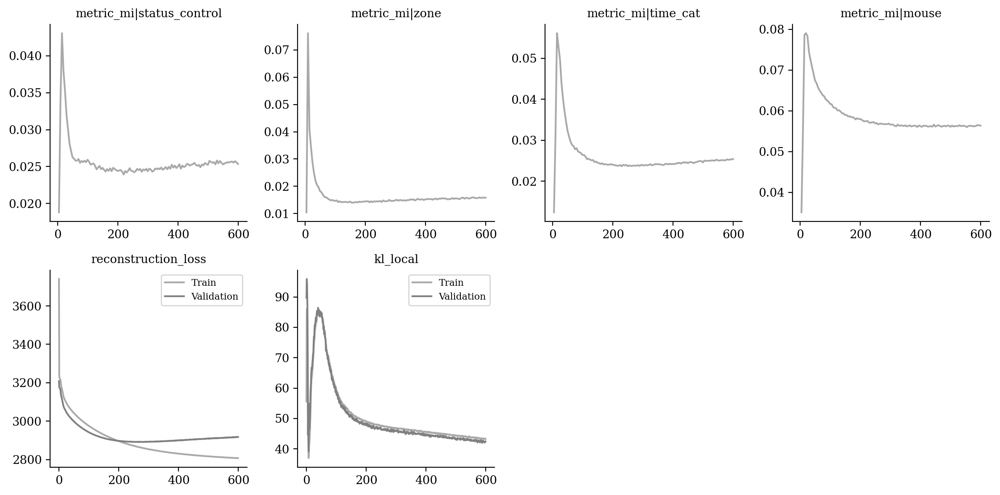

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

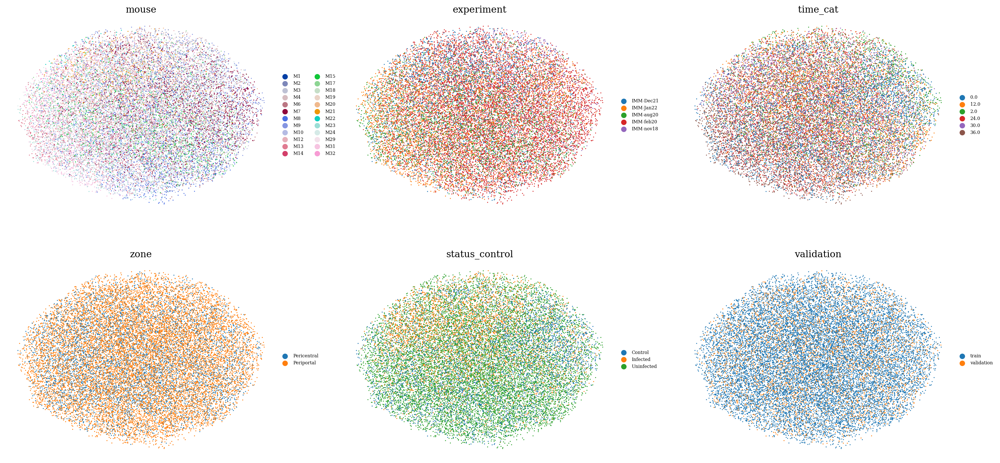

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

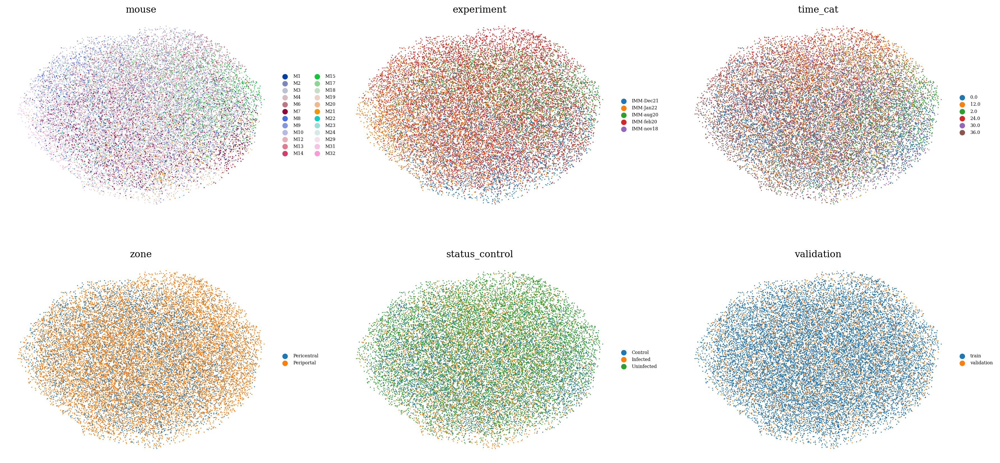

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

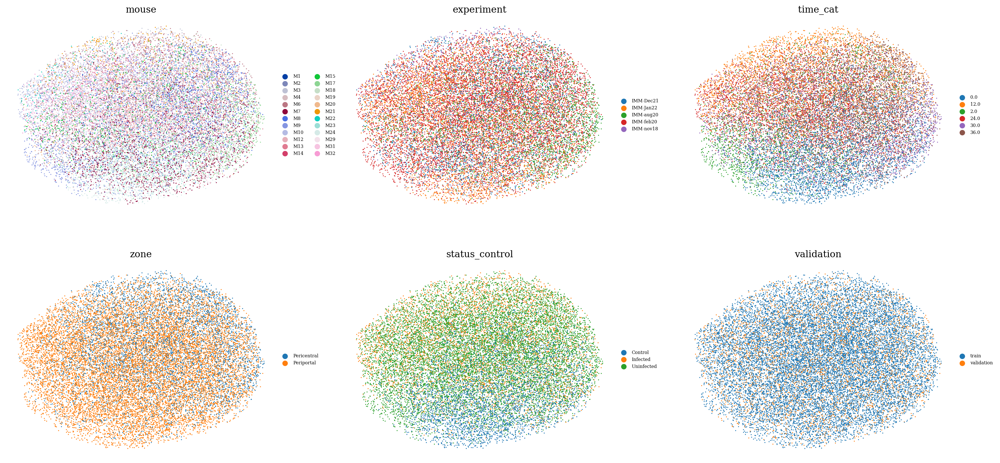

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

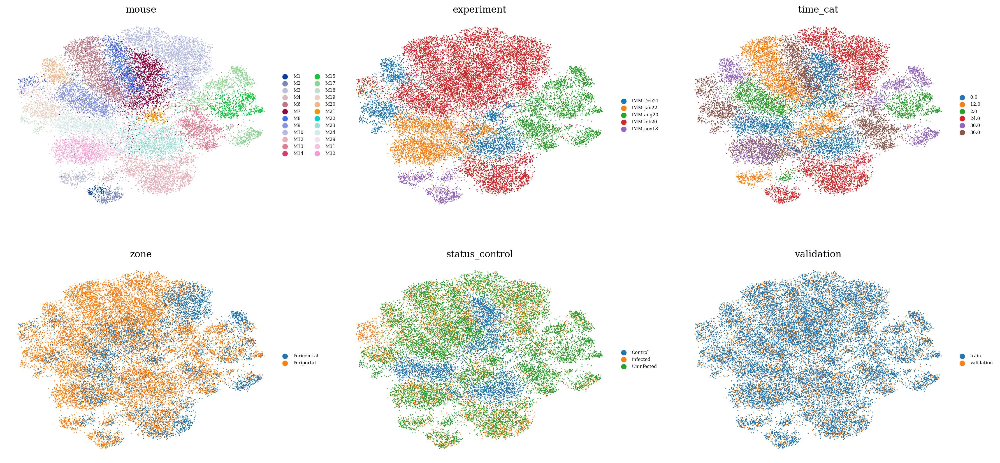

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

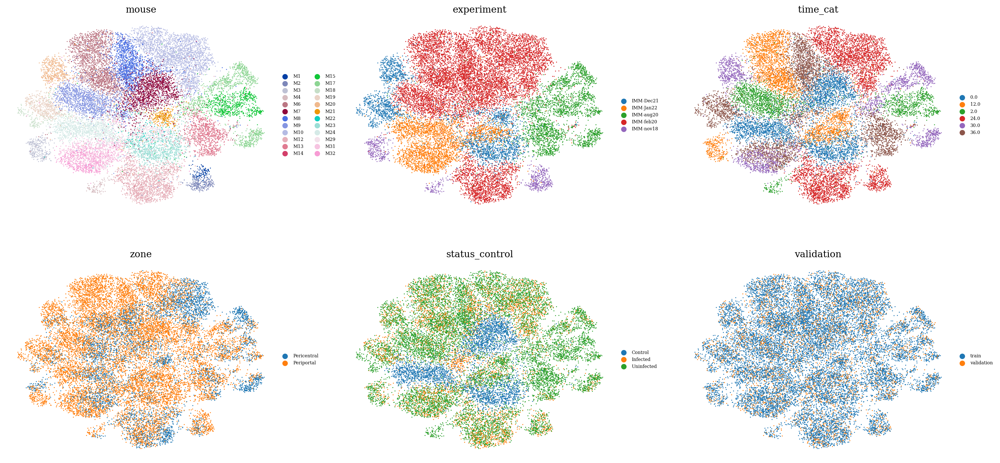

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

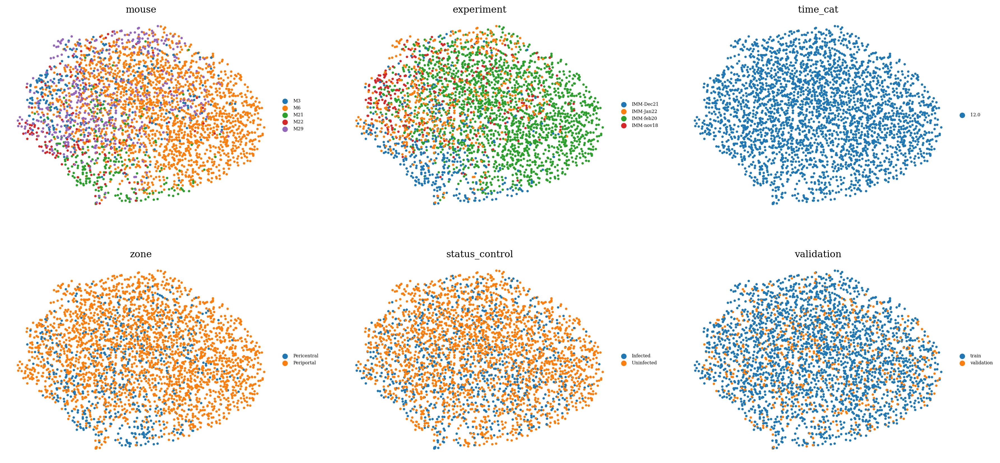

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )